# Explainer notebook: Final Project Notebook - Disney Network Analysis

This notebook contains all analysis showed as results in the paper "*Identifying the level of gender bias in the Disney network*" made by Cecilie Jürgens, Harald Lissau and Nojan Rezvani.

The data, attribute list and network as an edgelist used in this analysis can be found in the following Githup reposity: https://github.com/cecilieesj/SocialGraphs2022FinalProject.git.

The reposity also contains: 
- The Python notebook with the code used for downloading all the Disney-fandom wiki pages, called *Download_fandom_data.ipynb*.
- The Python notebook with the code used for creating the network and the attributes csv file, called *Network_generator.ipynb*.
- The Python notebook with the code used for calculating the sentiment scores, called *Sentiment_score_generator.ipynb*.

In [145]:
# Import packages
import matplotlib.pyplot as plt
import numpy as np
import random
import networkx as nx
import math
import collections
import statistics
import fandom
import re
import os
import statistics as st
from fa2 import ForceAtlas2
import pandas as pd
from collections import Counter
import matplotlib.patches as mpatches
from matplotlib.lines import Line2D

import community
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import re, pprint
import nltk
from nltk import word_tokenize
from nltk import * 
from sklearn.feature_extraction.text import TfidfVectorizer

import urllib.request 
import json 
from urllib.parse import quote
import nltk, pprint

# Reading datatable with attributes for each character

In [2]:
# Reading attributes from csv file
df = pd.read_csv('Attributes.csv')

In [3]:
# Reading network from edgelist
G = nx.read_edgelist("G.edgelist", delimiter='\t', create_using=nx.DiGraph) 
G = nx.DiGraph(G)

In [4]:
# Adding attributes to each character
for i in range(0,len(df)):
    G.add_node(df["character"][i], gender = df["gender"][i], good_vs_bad = df["good_vs_bad"][i], universe = df["universe"][i], first_movie = df["first_movie"][i], release_year = df["release_year"][i], sentiment_score = df["sentiment_score"][i])

In [5]:
# Testing an example to see if it works
G.nodes()["Ursula"]

{'gender': 'Female',
 'good_vs_bad': 'Villain',
 'universe': 'Disney',
 'first_movie': 'The Little Mermaid',
 'release_year': '1989',
 'sentiment_score': '5.42698741592538'}

In [6]:
# Checking the size of the network
print("The number of nodes in the network G is: " + str(len(G.nodes())))
print("The number of edges in the network G is: " + str(len(G.edges())))

The number of nodes in the network G is: 10053
The number of edges in the network G is: 76636


# Gender distribution in the network

### Graphs colored according to attributes

#### Gender:

In [108]:
# Make network undirected
G_undir = G.to_undirected()

In [8]:
# Initialization
sizes = []
color_map = []

# create node sizes and colormap
for char in list(G_undir.nodes()):
    # node size
    sizes.append(G_undir.degree(char))
    # node color
    if nx.get_node_attributes(G_undir, "gender")[char] == "Male":
        color_map.append("#40b4f7")
    elif nx.get_node_attributes(G_undir, "gender")[char] == "Female":
        color_map.append("#fa16a7")
    else:
        color_map.append("#f5f0f0")

In [115]:
# Force Atlas algorithm
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=True,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=0.001,  # This needed to be adjusted to show nodes properly
                        strongGravityMode=False,
                        gravity=1.0,

                        # Log
                        verbose=True)

pos = forceatlas2.forceatlas2_networkx_layout(G_undir, pos=None, iterations=100)

100%|██████████| 100/100 [01:25<00:00,  1.16it/s]

BarnesHut Approximation  took  13.14  seconds
Repulsion forces  took  70.06  seconds
Gravitational forces  took  0.18  seconds
Attraction forces  took  0.28  seconds
AdjustSpeedAndApplyForces step  took  1.08  seconds


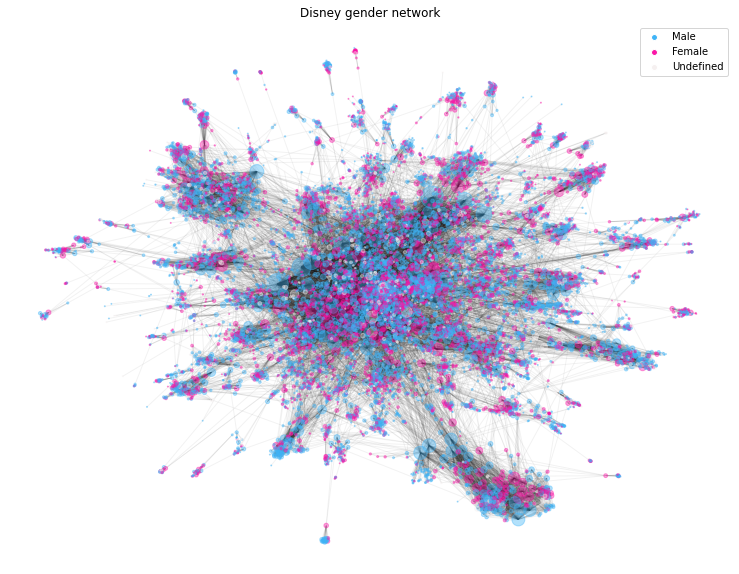

In [10]:
# Create legend
male_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#40b4f7', label='Male')
female_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#fa16a7', label='Female')
other_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#f5f0f0', label='Undefined')

# Plot of superhero network
plt.figure(figsize=(13,10))
nx.draw_networkx_nodes(G_undir, pos, node_size=sizes, node_color=color_map, alpha=0.4)
nx.draw_networkx_edges(G_undir, pos, edge_color="black", alpha=0.05)
plt.axis('off')
plt.title("Disney gender network")
plt.legend(handles=[male_dot, female_dot, other_dot])
#plt.savefig('Disney_gender_network.png', bbox_inches='tight')
#plt.savefig('Disney_gender_network.eps', bbox_inches='tight')
plt.show()

#### Good vs bad:

In [11]:
# Initialization
sizes = []
color_map = []

# create node sizes and colormap
for char in list(G_undir.nodes()):
    # node size
    sizes.append(G_undir.degree(char))
    # node color
    if nx.get_node_attributes(G_undir, "good_vs_bad")[char] == "Villain":
        color_map.append("#ff0000")
    elif nx.get_node_attributes(G_undir, "good_vs_bad")[char] == "Hero":
        color_map.append("#0515f5")
    elif nx.get_node_attributes(G_undir, "good_vs_bad")[char] == "Heroine":
        color_map.append("#53cff5")
    else:
        color_map.append("#f5f0f0")

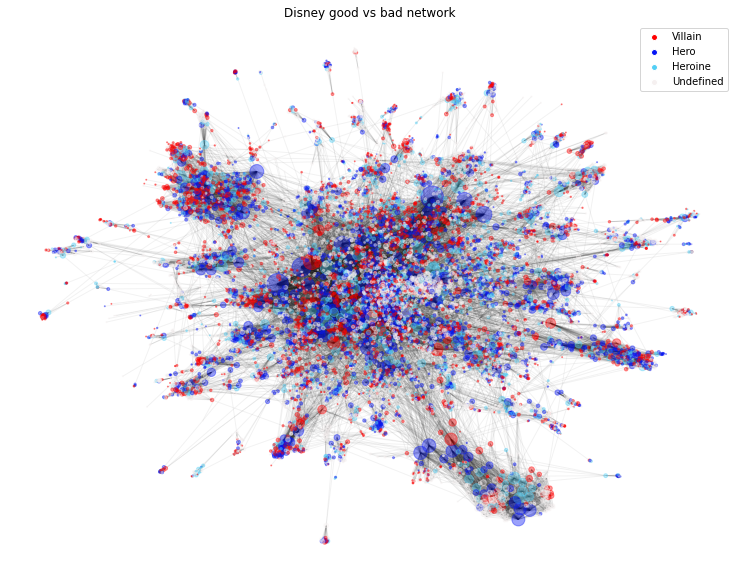

In [12]:
# Create legend
villain_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#ff0000', label='Villain')
hero_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#0515f5', label='Hero')
heroine_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#53cff5', label='Heroine')
other_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#f5f0f0', label='Undefined')

# Plot of superhero network
plt.figure(figsize=(13,10))
nx.draw_networkx_nodes(G_undir, pos, node_size=sizes, node_color=color_map, alpha=0.4)
nx.draw_networkx_edges(G_undir, pos, edge_color="black", alpha=0.05)
plt.axis('off')
plt.title("Disney good vs bad network")
plt.legend(handles=[villain_dot, hero_dot, heroine_dot, other_dot])
#plt.savefig('Disney_good_vs_bad_network.png', bbox_inches='tight')
#plt.savefig('Disney_good_vs_bad_network.eps', bbox_inches='tight')
plt.show()

#### Universes:

In [13]:
# Initialization
sizes = []
color_map = []

# create node sizes and colormap
for char in list(G_undir.nodes()):
    # node size
    sizes.append(G_undir.degree(char))
    # node color
    if nx.get_node_attributes(G_undir, "universe")[char] == "Disney":
        color_map.append("b")
    elif nx.get_node_attributes(G_undir, "universe")[char] == "Pixar":
        color_map.append("c")
    elif nx.get_node_attributes(G_undir, "universe")[char] == "Marvel":
        color_map.append("r")
    elif nx.get_node_attributes(G_undir, "universe")[char] == "Star Wars":
        color_map.append("k")
    else:
        color_map.append("#f5f0f0")

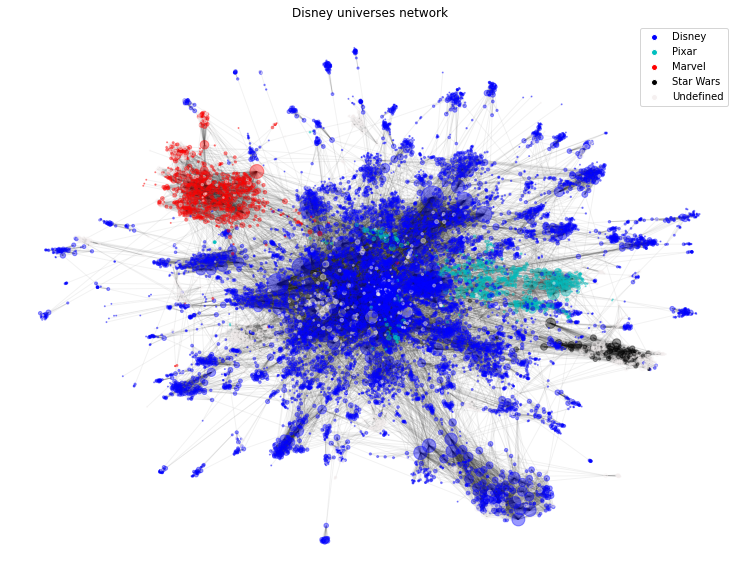

In [14]:
# Create legend
disney_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='b', label='Disney')
pixar_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='c', label='Pixar')
marvel_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='r', label='Marvel')
starwars_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='k', label='Star Wars')
other_dot = Line2D([0], [0], color='w', marker='o', markerfacecolor='#f5f0f0', label='Undefined')

# Plot of superhero network
plt.figure(figsize=(13,10))
nx.draw_networkx_nodes(G_undir, pos, node_size=sizes, node_color=color_map, alpha=0.4)
nx.draw_networkx_edges(G_undir, pos, edge_color="black", alpha=0.05)
plt.axis('off')
plt.title("Disney universes network")
plt.legend(handles=[disney_dot, pixar_dot, marvel_dot, starwars_dot, other_dot])
#plt.savefig('Disney_universes_network.png', bbox_inches='tight')
#plt.savefig('Disney_universes_network.eps', bbox_inches='tight')
plt.show()

### Statistics based on seperation of gender

In [11]:
# Creating list of characters based on seperating genders
male_char = []
female_char = []
other_char = []

for char in list(G.nodes()):
    if nx.get_node_attributes(G, "gender")[char] == "Male":
        male_char.append(char)
    elif nx.get_node_attributes(G, "gender")[char] == "Female":
        female_char.append(char)
    else:
        other_char.append(char)

In [12]:
# Create subgraphs of each gender
G_Male = G.subgraph(male_char)
G_Female = G.subgraph(female_char)
G_Other = G.subgraph(other_char)

In [15]:
# Checking the size of each list
print("Size of Male list:", len(male_char), ", Female list:", len(female_char), ", Undefined list:", len(other_char))

Size of Male list: 5771 , Female list: 3347 , Undefined list: 935


In [16]:
# Checking the size of the male network
print("The number of nodes in the network G_Male is: " + str(len(G_Male.nodes())))
print("The number of edges in the network G_Male is: " + str(len(G_Male.edges())))

The number of nodes in the network G_Male is: 5771
The number of edges in the network G_Male is: 29000


In [17]:
# Checking the size of the female network
print("The number of nodes in the network G_Female is: " + str(len(G_Female.nodes())))
print("The number of edges in the network G_Female is: " + str(len(G_Female.edges())))

The number of nodes in the network G_Female is: 3347
The number of edges in the network G_Female is: 10419


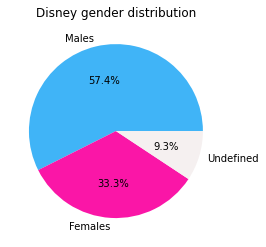

In [18]:
# Piechart of gender distribution
x = [len(male_char), len(female_char), len(other_char)]
l = ["Males", "Females", "Undefined"]
c = ["#40b4f7", "#fa16a7", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney gender distribution")
plt.savefig('Disney_gender_distribution_piechart.png', bbox_inches='tight')
plt.savefig('Disney_gender_distribution_piechart.eps', bbox_inches='tight')
plt.show() 

In [58]:
# Creating list of female characters based on seperating good vs bad
heroine_char = []
female_villain_char = []
female_neutral_char = []

for char in female_char:
    if nx.get_node_attributes(G, "good_vs_bad")[char] == "Heroine":
        heroine_char.append(char)
    elif nx.get_node_attributes(G, "good_vs_bad")[char] == "Villain":
        female_villain_char.append(char)
    else:
        female_neutral_char.append(char)

In [59]:
# Creating list of male characters based on seperating good vs bad
hero_char = []
male_villain_char = []
male_neutral_char = []

for char in male_char:
    if nx.get_node_attributes(G, "good_vs_bad")[char] == "Hero":
        hero_char.append(char)
    elif nx.get_node_attributes(G, "good_vs_bad")[char] == "Villain":
        male_villain_char.append(char)
    else:
        male_neutral_char.append(char)

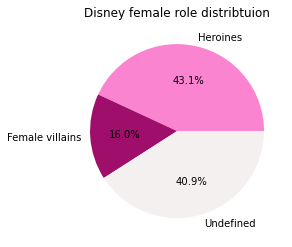

In [61]:
# Piechart of female roles distribution
x = [len(heroine_char), len(female_villain_char), len(female_neutral_char)]
l = ["Heroines", "Female villains", "Undefined"]
c = ["#fa84cf", "#9e0e6a", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney female role distribtuion")
plt.savefig('Disney_female_distribution_piechart.png', bbox_inches='tight')
plt.savefig('Disney_female_distribution_piechart.eps', bbox_inches='tight')
plt.show() 

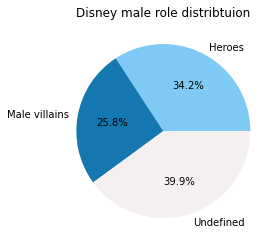

In [62]:
# Piechart of male roles distribution
x = [len(hero_char), len(male_villain_char), len(male_neutral_char)]
l = ["Heroes", "Male villains", "Undefined"]
c = ["#7fcaf5", "#1577b0", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney male role distribtuion")
plt.savefig('Disney_male_distribution_piechart.png', bbox_inches='tight')
plt.savefig('Disney_male_distribution_piechart.eps', bbox_inches='tight')
plt.show() 

In [13]:
# Creating list of characters based on seperating universe
disney_char = []
pixar_char = []
marvel_char = []
starwars_char = []
other_char = []

for char in list(G.nodes()):
    if nx.get_node_attributes(G, "universe")[char] == "Disney":
        disney_char.append(char)
    elif nx.get_node_attributes(G, "universe")[char] == "Pixar":
        pixar_char.append(char)
    elif nx.get_node_attributes(G, "universe")[char] == "Marvel":
        marvel_char.append(char)
    elif nx.get_node_attributes(G, "universe")[char] == "Star Wars":
        starwars_char.append(char)
    else:
        other_char.append(char)

In [14]:
# Create subgraphs of each universe
G_Disney = G.subgraph(disney_char)
G_Pixar = G.subgraph(pixar_char)
G_Marvel = G.subgraph(marvel_char)
G_Starwars = G.subgraph(starwars_char)

In [15]:
# Creating list of characters based on seperating genders in disney universe
disney_male_char = []
disney_female_char = []
disney_other_char = []

for char in list(G_Disney.nodes()):
    if nx.get_node_attributes(G_Disney, "gender")[char] == "Male":
        disney_male_char.append(char)
    elif nx.get_node_attributes(G_Disney, "gender")[char] == "Female":
        disney_female_char.append(char)
    else:
        disney_other_char.append(char)

In [26]:
print("Disney: Size of Male list:", len(disney_male_char), ", Female list:", len(disney_female_char), ", Undefined list:", len(disney_other_char))

Disney: Size of Male list: 4422 , Female list: 2590 , Undefined list: 629


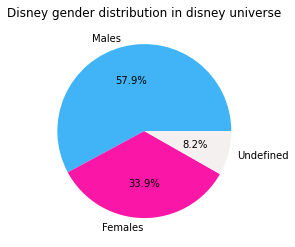

In [16]:
# Piechart of gender distribution in disney universe
x = [len(disney_male_char), len(disney_female_char), len(disney_other_char)]
l = ["Males", "Females", "Undefined"]
c = ["#40b4f7", "#fa16a7", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney gender distribution in disney universe")
plt.show()

In [17]:
# Creating list of characters based on seperating genders in pixar universe
pixar_male_char = []
pixar_female_char = []
pixar_other_char = []

for char in list(G_Pixar.nodes()):
    if nx.get_node_attributes(G_Pixar, "gender")[char] == "Male":
        pixar_male_char.append(char)
    elif nx.get_node_attributes(G_Pixar, "gender")[char] == "Female":
        pixar_female_char.append(char)
    else:
        pixar_other_char.append(char)

In [29]:
print("Pixar: Size of Male list:", len(pixar_male_char), ", Female list:", len(pixar_female_char), ", Undefined list:", len(pixar_other_char))

Pixar: Size of Male list: 333 , Female list: 163 , Undefined list: 57


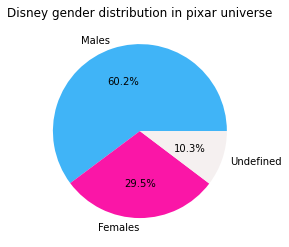

In [18]:
# Piechart of gender distribution in pixar universe
x = [len(pixar_male_char), len(pixar_female_char), len(pixar_other_char)]
l = ["Males", "Females", "Undefined"]
c = ["#40b4f7", "#fa16a7", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney gender distribution in pixar universe")
plt.show()

In [19]:
# Creating list of characters based on seperating genders in marvel universe
marvel_male_char = []
marvel_female_char = []
marvel_other_char = []

for char in list(G_Marvel.nodes()):
    if nx.get_node_attributes(G_Marvel, "gender")[char] == "Male":
        marvel_male_char.append(char)
    elif nx.get_node_attributes(G_Marvel, "gender")[char] == "Female":
        marvel_female_char.append(char)
    else:
        marvel_other_char.append(char)

In [32]:
print("Marvel: Size of Male list:", len(marvel_male_char), ", Female list:", len(marvel_female_char), ", Undefined list:", len(marvel_other_char))

Marvel: Size of Male list: 306 , Female list: 163 , Undefined list: 79


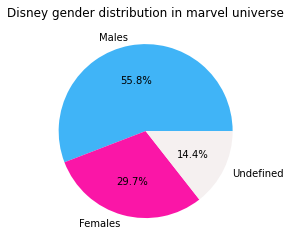

In [20]:
# Piechart of gender distribution in marvel universe
x = [len(marvel_male_char), len(marvel_female_char), len(marvel_other_char)]
l = ["Males", "Females", "Undefined"]
c = ["#40b4f7", "#fa16a7", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney gender distribution in marvel universe")
plt.show()

In [21]:
# Creating list of characters based on seperating genders in star wars universe
starwars_male_char = []
starwars_female_char = []
starwars_other_char = []

for char in list(G_Starwars.nodes()):
    if nx.get_node_attributes(G_Starwars, "gender")[char] == "Male":
        starwars_male_char.append(char)
    elif nx.get_node_attributes(G_Starwars, "gender")[char] == "Female":
        starwars_female_char.append(char)
    else:
        starwars_other_char.append(char)

In [35]:
print("Star Wars: Size of Male list:", len(starwars_male_char), ", Female list:", len(starwars_female_char), ", Undefined list:", len(starwars_other_char))

Star Wars: Size of Male list: 47 , Female list: 17 , Undefined list: 12


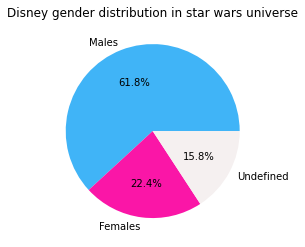

In [22]:
# Piechart of gender distribution in star wars universe
x = [len(starwars_male_char), len(starwars_female_char), len(starwars_other_char)]
l = ["Males", "Females", "Undefined"]
c = ["#40b4f7", "#fa16a7", "#f5f0f0"]

plt.pie(x, labels = l, colors = c, autopct='%1.1f%%')
plt.title("Disney gender distribution in star wars universe")
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


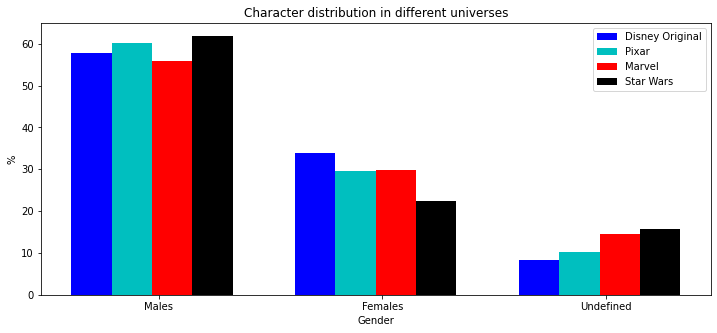

In [68]:
# Plotting percentage of gender in different universes
percent_d = len(G_Disney.nodes())
x_disney = [len(disney_male_char)/percent_d*100, len(disney_female_char)/percent_d*100, len(disney_other_char)/percent_d*100]

percent_p = len(G_Pixar.nodes())
x_pixar = [len(pixar_male_char)/percent_p*100, len(pixar_female_char)/percent_p*100, len(pixar_other_char)/percent_p*100]

percent_m = len(G_Marvel.nodes())
x_marvel = [len(marvel_male_char)/percent_m*100, len(marvel_female_char)/percent_m*100, len(marvel_other_char)/percent_m*100]

percent_s = len(G_Starwars.nodes())
x_starwars = [len(starwars_male_char)/percent_s*100, len(starwars_female_char)/percent_s*100, len(starwars_other_char)/percent_s*100]

l = ["Males", "Females", "Undefined"]

# set width of bar
barWidth = 0.18
fig = plt.subplots(figsize =(12, 5))

br1 = np.arange(len(x_disney))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]

plt.bar(br1,x_disney, color = "b", width = barWidth)
plt.bar(br2,x_pixar, color = "c", width = barWidth)
plt.bar(br3,x_marvel, color = "r", width = barWidth)
plt.bar(br4,x_starwars, color = "k", width = barWidth)
plt.legend(["Disney Original", "Pixar", "Marvel", "Star Wars"])
plt.title("Character distribution in different universes")
plt.xlabel("Gender")
plt.ylabel("%")
plt.xticks([r + 0.3 for r in range(len(x_disney))],l)
plt.savefig('Disney_distribution_universes1.png', bbox_inches='tight')
plt.savefig('Disney_distribution_universes1.eps', bbox_inches='tight')
plt.show()

### Gender distributions over time

In [52]:
# Creating a list of all release years
x_all = []

for char in list(G.nodes()):
    x_all.append(nx.get_node_attributes(G, "release_year")[char])

In [53]:
# Removing "None" from list
x_all = [i for i in x_all if i != "None"]

In [54]:
# Number of characters with release year attributes other than "None"
len(x_all)

3524

In [55]:
# Creating dictionary of all release years
c_all = Counter(np.sort(x_all))

In [56]:
# Creating a list of release years for female characters
x_female = []
y_female = []

for female in list(G_Female.nodes()):
    x_female.append(nx.get_node_attributes(G_Female, "release_year")[female])
    y_female.append(nx.get_node_attributes(G_Female, "good_vs_bad")[female])

In [57]:
# Creating a list of release years for male characters
x_male = []
y_male = []

for male in list(G_Male.nodes()):
    x_male.append(nx.get_node_attributes(G_Male, "release_year")[male])
    y_male.append(nx.get_node_attributes(G_Male, "good_vs_bad")[male])

In [58]:
# Removing "None" from lists
x_female = [i for i in x_female if i != "None"]
x_male = [i for i in x_male if i != "None"]

In [59]:
# Creating dictionary of release years
c_female = Counter(np.sort(x_female))
c_male = Counter(np.sort(x_male))

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


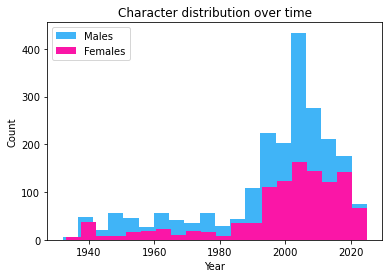

In [60]:
# Plotting number of characters over time
plt.hist(np.asarray(x_male, float), bins=20, color="#40b4f7")
plt.hist(np.asarray(x_female, float), bins=20, color = "#fa16a7")
plt.legend(["Males", "Females"])
plt.title("Character distribution over time")
plt.xlabel("Year")
plt.ylabel("Count")
plt.savefig('Disney_character_release_distribution_histogram.png', bbox_inches='tight')
plt.savefig('Disney_character_release_distribution_histogram.eps', bbox_inches='tight')
plt.show()

In [61]:
# Count of character released from the earliest 30 years (1930-1960)
sum(np.sort(np.asarray(x_male, float)) < 1960)

203

In [62]:
# Count of character released from the latest 30 years (1995-2025)
sum(1995 < np.sort(np.asarray(x_male, float)))

1479

In [63]:
# Creating dictionaries for male and female character with their release year and percentage of characters from that year
male_percentage = {}
female_percentage = {}

for year in list(c_all):
    if year in list(c_male):
        male_percentage.update({year: c_male[year]/c_all[year]*100})
    else:
        male_percentage.update({year: 0})
            
    if year in list(c_female):
        female_percentage.update({year: c_female[year]/c_all[year]*100})
    else:
        female_percentage.update({year: 0})

In [64]:
# Creating list of the percentages for male and female characters
male_p = [male_percentage[year] for year in list(male_percentage)]
female_p = [female_percentage[year] for year in list(female_percentage)]

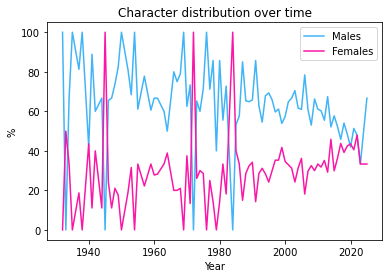

In [65]:
# Plotting the percentages of female and male characters released over time
plt.plot(np.asarray(list(male_percentage),float), male_p, color="#40b4f7")
plt.plot(np.asarray(list(female_percentage),float), female_p, color = "#fa16a7")
plt.legend(["Males", "Females"])
plt.title("Character distribution over time")
plt.xlabel("Year")
plt.ylabel("%")
plt.show()

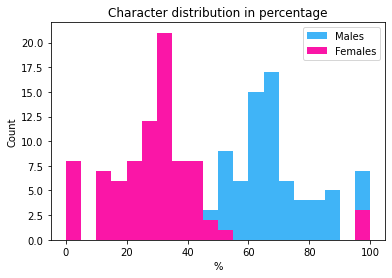

In [66]:
# Plotting the number of female and male characters released in percentages
plt.hist(np.asarray(male_p, float), bins=20, color="#40b4f7")
plt.hist(np.asarray(female_p, float), bins=20, color = "#fa16a7")
plt.title("Character distribution in percentage")
plt.legend(["Males", "Females"])
plt.xlabel("%")
plt.ylabel("Count")
plt.show()

In [67]:
# Function that groups years by 5 year periode
def group_by_5s(mylist):
    result = []
    decade = -1
    for i in sorted(mylist):
        while i // 5 != decade:
            result.append([])
            decade += 1
        result[-1].append(i)
    return result

In [68]:
# Creating a list of counted grouped years
group_year = [x for x in group_by_5s(np.asarray(list(male_percentage),float)) if x]
group_year = group_year[:-1]
count_group_year = [len(count) for count in group_year]

In [69]:
# Grouping the percentages for female and male by 5 year periode
i = 0
male_year_5 = []
female_year_5 = []

for count in count_group_year:
    male_year_5.append(np.sum(np.asarray(list(male_p),float)[i:i+count])/(count*100)*100)
    female_year_5.append(np.sum(np.asarray(list(female_p),float)[i:i+count])/(count*100)*100)
    i = i+count

In [70]:
# Creating a list of the first year from every year group
x_year_5 = [group[0] for group in group_year]

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


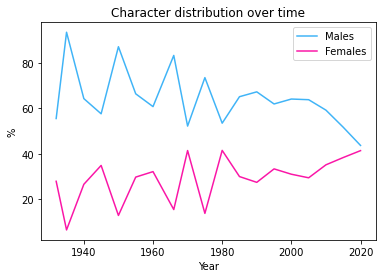

In [71]:
# # Plotting the percentages of female and male characters released over time (grouped by 5 year periode)
plt.plot(x_year_5, male_year_5, color="#40b4f7")
plt.plot(x_year_5, female_year_5, color ="#fa16a7")
plt.title("Character distribution over time")
plt.legend(["Males", "Females"])
plt.xlabel("Year")
plt.ylabel("%")
plt.savefig('Disney_character_release_distribution_plot.png', bbox_inches='tight')
plt.savefig('Disney_character_release_distribution_plot.eps', bbox_inches='tight')
plt.show()

### In and out-degree for gender

In [9]:
# list of in-degrees males
in_deg_male = []
for char in list(G_Male.nodes()):
    in_deg_male.append(G_Male.in_degree(char))

# list of in-degrees females
in_deg_female = []
for char in list(G_Female.nodes()):
    in_deg_female.append(G_Female.in_degree(char))

In [38]:
# statistics of male and female network
print("The mean of the in-degree is; Male: " + str(st.mean(in_deg_male)) + ", Female: " + str(st.mean(in_deg_female)))
print("The median of the in-degree is; Male: " + str(st.median(in_deg_male)) + ", Female: " + str(st.median(in_deg_female)))
print("The mode of the in-degree is; Male: " + str(st.mode(in_deg_male)) + ", Female: " + str(st.mode(in_deg_female)))
print("The maximum of the in-degree is; Male: " + str(max(in_deg_male)) + ", Female: " + str(max(in_deg_female)))
print("The minimum of the in-degree is; Male: " + str(min(in_deg_male)) + ", Female: " + str(min(in_deg_female)))

The mean of the in-degree is; Male: 5.025125628140704, Female: 3.112936958470272
The median of the in-degree is; Male: 2, Female: 1
The mode of the in-degree is; Male: 0, Female: 0
The maximum of the in-degree is; Male: 322, Female: 85
The minimum of the in-degree is; Male: 0, Female: 0


In [25]:
# list of out-degrees marvel
out_deg_male = []
for char in list(G_Male.nodes()):
    out_deg_male.append(G_Male.out_degree(char))

# list of out-degrees DC
out_deg_female = []
for char in list(G_Female.nodes()):
    out_deg_female.append(G_Female.out_degree(char))

In [40]:
# statistics of male and female network
print("The mean of the out-degree is; Male: " + str(st.mean(out_deg_male)) + ", Female: " + str(st.mean(out_deg_female)))
print("The median of the out-degree is; Male: " + str(st.median(out_deg_male)) + ", Female: " + str(st.median(out_deg_female)))
print("The mode of the out-degree is; Male: " + str(st.mode(out_deg_male)) + ", Female: " + str(st.mode(out_deg_female)))
print("The maximum of the out-degree is; Male: " + str(max(out_deg_male)) + ", Female: " + str(max(out_deg_female)))
print("The minimum of the out-degree is; Male: " + str(min(out_deg_male)) + ", Female: " + str(min(out_deg_female)))

The mean of the out-degree is; Male: 5.025125628140704, Female: 3.112936958470272
The median of the out-degree is; Male: 4, Female: 2
The mode of the out-degree is; Male: 2, Female: 1
The maximum of the out-degree is; Male: 68, Female: 40
The minimum of the out-degree is; Male: 0, Female: 0


In [41]:
# Creating a network that only consist of female and male characters
G_mf = nx.DiGraph(G)

for char in list(G_mf.nodes()):
    if nx.get_node_attributes(G_mf, "gender")[char] == "Other":
        G_mf.remove_node(char)                                   

In [42]:
# Initialization
male_female_links = 0
male_male_links = 0
female_female_links = 0

# Count each edge between male and female characters
for char in list(G_mf.nodes()):
    for i in range(len(list(G_mf.edges(char)))):
        label_1 = nx.get_node_attributes(G_mf, "gender")[list(G_mf.edges(char))[i][0]] 
        label_2 = nx.get_node_attributes(G_mf, "gender")[list(G_mf.edges(char))[i][1]]
        if (label_1 != label_2):
            male_female_links += 1
        elif (label_1 and label_2 == "Male"):
            male_male_links += 1
        elif (label_1 and label_2 == "Female"):
            female_female_links += 1

In [43]:
print("The number of links connecting male and female charachters: " + str(male_female_links))
print("The percentage of links connecting the two genders: " + str(round(male_female_links/len(G.edges())*100,4)) + " %", "\n")

print("The number of links connecting male and male charachters: " + str(male_male_links))
print("The percentage of links connecting the two males: " + str(round(male_male_links/len(G.edges())*100,4)) + " %", "\n")

print("The number of links connecting female and female charachters: " + str(female_female_links))
print("The percentage of links connecting the two females: " + str(round(female_female_links/len(G.edges())*100,4)) + " %", "\n")

other_links = len(G.edges()) - male_female_links - male_male_links - female_female_links
print("The number of links connecting with other charachters: " + str(other_links))
print("The percentage of links connecting with other characters: " + str(round(other_links/len(G.edges())*100,4)) + " %", "\n")

The number of links connecting male and female charachters: 28329
The percentage of links connecting the two genders: 36.9657 % 

The number of links connecting male and male charachters: 29000
The percentage of links connecting the two males: 37.8412 % 

The number of links connecting female and female charachters: 10419
The percentage of links connecting the two females: 13.5954 % 

The number of links connecting with other charachters: 8888
The percentage of links connecting with other characters: 11.5977 % 



The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


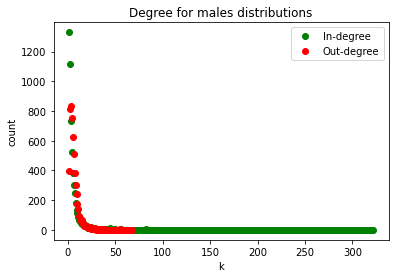

In [26]:
# Plotting in- and out-degree for male characters
x = range(1, max(in_deg_male)+1)
y = np.histogram(in_deg_male, bins=max(in_deg_male))[0]

xx = range(1, max(out_deg_male)+1)
yy = np.histogram(out_deg_male, bins=max(out_deg_male))[0]

plt.plot(x, y, 'go', label='In-degree')
plt.plot(xx, yy, 'ro', label='Out-degree')
plt.title("Degree for males distributions")
plt.xlabel("k")
plt.ylabel("count")
plt.legend()
plt.savefig('Disney_male_degree.png', bbox_inches='tight')
plt.savefig('Disney_male_degree.eps', bbox_inches='tight')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


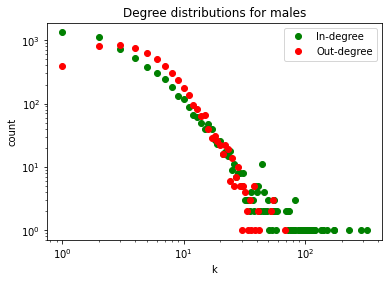

In [27]:
# Plotting in- and out-degree for male characters in log-log scale
plt.loglog(x, y, 'go', label='In-degree')
plt.loglog(xx, yy, 'ro', label='Out-degree')
plt.title("Degree distributions for males")
plt.xlabel("k")
plt.ylabel("count")
plt.legend()
plt.savefig('Disney_male_degree_loglog.png', bbox_inches='tight')
plt.savefig('Disney_male_degree_loglog.eps', bbox_inches='tight')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


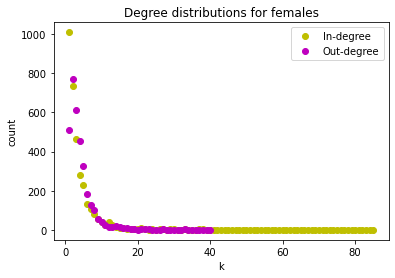

In [28]:
# Plotting in- and out-degree for female characters
x = range(1, max(in_deg_female)+1)
y = np.histogram(in_deg_female, bins=max(in_deg_female))[0]

xx = range(1, max(out_deg_female)+1)
yy = np.histogram(out_deg_female, bins=max(out_deg_female))[0]

plt.plot(x, y, 'yo', label='In-degree')
plt.plot(xx, yy, 'mo', label='Out-degree')
plt.title("Degree distributions for females")
plt.xlabel("k")
plt.ylabel("count")
plt.legend()
plt.savefig('Disney_female_degree.png', bbox_inches='tight')
plt.savefig('Disney_female_degree.eps', bbox_inches='tight')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


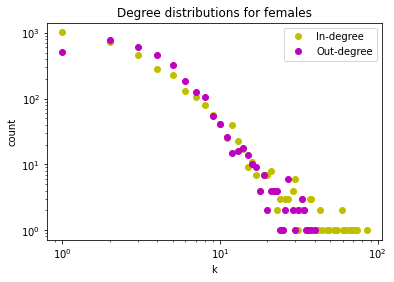

In [29]:
# Plotting in- and out-degree for female characters in log-log scale
plt.loglog(x, y, 'yo', label='In-degree')
plt.loglog(xx, yy, 'mo', label='Out-degree')
plt.title("Degree distributions for females")
plt.xlabel("k")
plt.ylabel("count")
plt.legend()
plt.savefig('Disney_female_degree_loglog.png', bbox_inches='tight')
plt.savefig('Disney_female_degree_loglog.eps', bbox_inches='tight')
plt.show()

In [19]:
# Creating the top 10 highest in degree male characters list
list_male = [number for name,number in G_Male.in_degree()]
list_male.sort()
highest_male = list_male[-10:]
male_name = [name for name,number in G_Male.in_degree() if number in highest_male]

In [20]:
# Printing the top 10 highest in degree male characters with their corresponding in-degree and role
for deg in list(reversed(highest_male)):
    for male in male_name:
        if G_Male.in_degree()[male] == deg:
            print(male, ",", nx.get_node_attributes(G, "release_year")[male], ",", deg)
            male_name.remove(male)

Donald Duck , 1941 , 322
Mickey Mouse , 1934 , 286
Goofy , 1941 , 231
Stitch , 2002 , 174
Pete , 1988 , 173
Huey, Dewey, and Louie , 1990 , 151
Jumba Jookiba , 2002 , 141
Scrooge McDuck , 1990 , 139
Captain Hook , 1953 , 134
Pleakley , 2002 , 121


In [21]:
# Creating the top 10 highest in degree male characters list
list_female = [number for name,number in G_Female.in_degree()]
list_female.sort()
highest_female = list_female[-10:]
female_name = [name for name,number in G_Female.in_degree() if number in highest_female]

In [22]:
# Printing the top 10 highest in degree female characters with their corresponding in-degree and role
for deg in list(reversed(highest_female)):
    for female in female_name:
        if G_Female.in_degree()[female] == deg:
            print(female, ",", nx.get_node_attributes(G, "release_year")[female], ",", deg)
            female_name.remove(female)

Sofia the First (character) , 2012 , 85
Ariel , 1989 , 73
Minnie Mouse , 1988 , 71
Belle , None , 69
Cinderella (character) , None , 67
Snow White , 1937 , 66
The Evil Queen , 1937 , 62
Cruella De Vil , 1961 , 59
Maleficent , 1959 , 58
Daisy Duck , 1999 , 58


# Communities

In [109]:
# We find all the communities using the community import. This returns a dictionary
partition = community.best_partition(G_undir)

In [110]:
community.modularity(partition,G_undir)

0.8484983185246557

In [ ]:
# for every community, print out their community number and number of nodes
print("there are" , 2+max([v for k,v in partition.items()]) , "communities in the :")

for x in range(0,1+max([v for k,v in partition.items()])):
    print ("Community ", x+1 , " has " , ([v for k,v in partition.items()]).count(x) , " number of nodes")

there are 82 communities in the :
Community  1  has  1061  number of nodes
Community  2  has  147  number of nodes
Community  3  has  236  number of nodes
Community  4  has  437  number of nodes
Community  5  has  984  number of nodes
Community  6  has  124  number of nodes
Community  7  has  95  number of nodes
Community  8  has  214  number of nodes
Community  9  has  167  number of nodes
Community  10  has  191  number of nodes
Community  11  has  448  number of nodes
Community  12  has  165  number of nodes
Community  13  has  154  number of nodes
Community  14  has  304  number of nodes
Community  15  has  235  number of nodes
Community  16  has  91  number of nodes
Community  17  has  127  number of nodes
Community  18  has  101  number of nodes
Community  19  has  118  number of nodes
Community  20  has  239  number of nodes
Community  21  has  93  number of nodes
Community  22  has  90  number of nodes
Community  23  has  693  number of nodes
Community  24  has  209  number of 

In [112]:
# Generate all the colors for communities
color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range( (max([v for k,v in partition.items()]))+1)]

In [114]:
sizes = []
color_map = []

# assign sizes of nodes and their color
for k,v in (partition.items()):
    # node size
    sizes.append(G_undir.degree(k))
    # node color
    color_map.append(color[v])

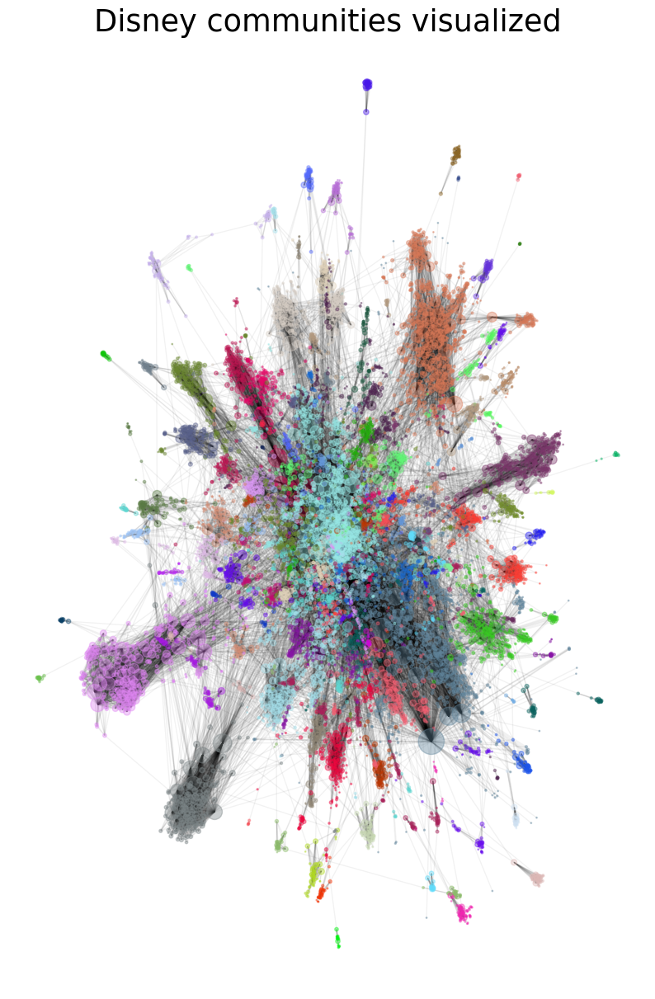

In [117]:
# Plot of disney
plt.figure(figsize=(10,15))

nx.draw_networkx_nodes(G_undir, pos, node_size=sizes, node_color=color_map, alpha=0.4)
nx.draw_networkx_edges(G_undir, pos, edge_color="black", alpha=0.05)
plt.axis('off')
plt.title("Disney communities visualized")
plt.show()

Now, we make the color map where the top 10 communities have distinct colors, and the rest have the color black

In [ ]:
topCommunities=[]
temp={}

# First we find all community numbers
for x in range(0,1+max([v for k,v in partition.items()])):
    temp[x]=(([v for k,v in partition.items()]).count(x))

# Then we sort that list, and pull out the top 10
i=0
for k,v in sorted(temp.items(), key=lambda p:p[1], reverse=True):
    i +=1
    topCommunities.append(k)
    if (i==10): break

print(topCommunities)

[0, 4, 22, 10, 3, 13, 33, 39, 19, 2]


In [119]:
# Pre defining a color array for each community with white color
color = ["#FFFFFF"]*((max([v for k,v in partition.items()]))+1)

# We hand pick 10 distinct colors for the top 10 communities, from https://sashamaps.net/docs/resources/20-colors/
distinctcolors= ["#3cb44b","#42d4f4","#ffe119","#f032e6","#e6194B","#f58231" ,"#bfef45","#911eb4","#000075","#9A6324"]

# Now, for each of our top communities, we change their color to one of the distinct ones
i = 0
for col in range(len(color)):
    if (col in topCommunities):
        color[col] = distinctcolors[i]
        i += 1

In [120]:
sizes = []
color_map = []

# assign sizes of nodes and their color
for k,v in (partition.items()):
    # node size
    sizes.append(G_undir.degree(k))
    # node color
    color_map.append(color[v])

In [121]:
# Plot of disney
plt.figure(figsize=(10,15), dpi= 1000)

nx.draw_networkx_nodes(G_undir, pos, node_size=sizes, node_color=color_map, alpha=0.4)
nx.draw_networkx_edges(G_undir, pos, edge_color="black", alpha=0.05)
plt.axis('off')
plt.title("Disney communities visualized")
plt.show()

## Gender data in communities

In [122]:
TopCommunitiesNodes=[]

# Go through all top communities, find all characters in that community, append all their pages together to form 1 document
# specific to that community, so that we end up with 10 documents in total
for com in topCommunities:
    listOfCharacters=(([k for k,v in partition.items() if v == com]))
    TopCommunitiesNodes.append(listOfCharacters)

In [ ]:
# Amount of nodes in total for the top 10 communities
amount = 0
for nodes in TopCommunitiesNodes:
    amount += len(nodes)
    
print ("Total nodes in network is: " + str(len(G.nodes())) + " , total nodes in top 10 communities: " + str(amount))

Total nodes in network is: 10053 , total nodes in top 10 communities: 4892


In [ ]:
# Function for returning amount of a specific category and attribute for each community
def attribute_selector_amount(com,cat,atr):
    amount = 0
    for node in com:
        if (G.nodes()[node].get(cat) == atr):
            amount += 1
    
    return amount 

In [ ]:
genderList=["Male","Female","Other"]

print("Gender breakdown for each of the top 10 communities")
print(" ")

for com in range(10):
    print("Top Community Number " , com+1, " has " , len(TopCommunitiesNodes[com]) , " characters in total:" )
    textGender = ""
    textGenderPercent= ""
    for gender in genderList:
        amount = attribute_selector_amount(TopCommunitiesNodes[com],"gender",gender)
        textGender += str(amount) + " "+ str(gender) + " characters; "
        textGenderPercent += str(round(amount/len(TopCommunitiesNodes[com])*100,2)) +" %"+ " "+ str(gender) + " characters; "
    print(textGender)
    print(textGenderPercent)
    print(" ")

Gender breakdown for each of the top 10 communities
 
Top Community Number  1  has  1061  characters in total:
649 Male characters; 263 Female characters; 149 Other characters; 
61.17 % Male characters; 24.79 % Female characters; 14.04 % Other characters; 
 
Top Community Number  2  has  984  characters in total:
535 Male characters; 356 Female characters; 93 Other characters; 
54.37 % Male characters; 36.18 % Female characters; 9.45 % Other characters; 
 
Top Community Number  3  has  693  characters in total:
390 Male characters; 212 Female characters; 91 Other characters; 
56.28 % Male characters; 30.59 % Female characters; 13.13 % Other characters; 
 
Top Community Number  4  has  448  characters in total:
250 Male characters; 152 Female characters; 46 Other characters; 
55.8 % Male characters; 33.93 % Female characters; 10.27 % Other characters; 
 
Top Community Number  5  has  437  characters in total:
274 Male characters; 108 Female characters; 55 Other characters; 
62.7 % Male 

Now we see the amount of ingoing outgoing edges for the top communities, that point to outside their own community

In [ ]:
totalOutDegree = [0]*10 
totalInDegree = [0]*10 

for com in range(10):
    for char in TopCommunitiesNodes[com]:
        totalOutDegree[com] += len(list(G.out_edges(char)))
        totalInDegree[com] += len(list(G.in_edges(char)))

In [ ]:
print("For all the top communities,")
print ("the amount of in and outgoing edges per gender, that point to outside their own community:")
print (" ")
for com in range(10):
    print ("Top community number " + str(com+1) + " , Total normal out degree: " + str(totalOutDegree[com])+ " , Total normal in degree: " + str(totalInDegree[com]))
    
    outAmount = [0]*3
    inAmount = [0]*3
    for char in TopCommunitiesNodes[com]:
        genderChar = 0
        if (G.nodes()[char].get("gender") == "Male"):
            genderChar = 0
        elif (G.nodes()[char].get("gender") == "Female"):
            genderChar = 1
        else:
            genderChar = 2
        
        for x,y in list(G.out_edges(char)):
            if y not in TopCommunitiesNodes[com]:
                outAmount[genderChar] += 1
                
        for x,y in list(G.in_edges(char)):
            if x not in TopCommunitiesNodes[com]:
                inAmount[genderChar] += 1   
    
    print ("Male: Out edges: " + str(outAmount[0]) + " , In edges: " + str(inAmount[0]) )
    print ("Male \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[0]+inAmount[0])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")
    print(" ")
    print ("Female: Out edges: " + str(outAmount[1]) + " , In edges: " + str(inAmount[1]) )
    print ("Female \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[1]+inAmount[1])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")
    print(" ")
    print ("Other: Out edges: " + str(outAmount[2]) + " , In edges: " + str(inAmount[2]) )
    print ("Other \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[2]+inAmount[2])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")

    print(" ")
    print(" ")

For all the top communities,
the amount of in and outgoing edges per gender, that point to outside their own community:
 
Top community number 1 , Total normal out degree: 7134 , Total normal in degree: 7581
Male: Out edges: 516 , In edges: 1004
Male "outside of community" edges percent of total "outside of community" : 76.5 %
 
Female: Out edges: 121 , In edges: 181
Female "outside of community" edges percent of total "outside of community" : 15.2 %
 
Other: Out edges: 133 , In edges: 32
Other "outside of community" edges percent of total "outside of community" : 8.3 %
 
 
Top community number 2 , Total normal out degree: 10881 , Total normal in degree: 10981
Male: Out edges: 769 , In edges: 990
Male "outside of community" edges percent of total "outside of community" : 50.93 %
 
Female: Out edges: 689 , In edges: 656
Female "outside of community" edges percent of total "outside of community" : 38.94 %
 
Other: Out edges: 219 , In edges: 131
Other "outside of community" edges percent 

### Combine both data points

In [ ]:
#Combined both data points
genderList=["Male","Female","Other"]

#print("Gender breakdown for each of the top 10 communities")
#print(" ")


print("For all the top communities,")
print ("the amount of in and outgoing edges per gender, that point to outside their own community:")
print("PLUS Gender breakdown for each of the top 10 communities")
print (" ")
for com in range(10):
    print ("Top Community Number " , com+1, " has " , len(TopCommunitiesNodes[com]) , " characters in total:" + " , Total normal out degree: " + str(totalOutDegree[com])+ " , Total normal in degree: " + str(totalInDegree[com]))
    print (" ")
    textGender = ""
    textGenderPercent= ""
    for gender in genderList:
        amount = attribute_selector_amount(TopCommunitiesNodes[com],"gender",gender)
        textGender += str(amount) + " "+ str(gender) + " characters; "
        textGenderPercent += str(round(amount/len(TopCommunitiesNodes[com])*100,2)) +" %"+ " "+ str(gender) + " characters; "
    print(textGender)
    print(textGenderPercent)
    print(" ")
    
    outAmount = [0]*3
    inAmount = [0]*3
    for char in TopCommunitiesNodes[com]:
        genderChar = 0
        if (G.nodes()[char].get("gender") == "Male"):
            genderChar = 0
        elif (G.nodes()[char].get("gender") == "Female"):
            genderChar = 1
        else:
            genderChar = 2
        
        for x,y in list(G.out_edges(char)):
            if y not in TopCommunitiesNodes[com]:
                outAmount[genderChar] += 1
                
        for x,y in list(G.in_edges(char)):
            if x not in TopCommunitiesNodes[com]:
                inAmount[genderChar] += 1   
    
    print ("Male: Out edges: " + str(outAmount[0]) + " , In edges: " + str(inAmount[0]) )
    print ("Male \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[0]+inAmount[0])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")
    print(" ")
    print ("Female: Out edges: " + str(outAmount[1]) + " , In edges: " + str(inAmount[1]) )
    print ("Female \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[1]+inAmount[1])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")
    print(" ")
    print ("Other: Out edges: " + str(outAmount[2]) + " , In edges: " + str(inAmount[2]) )
    print ("Other \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[2]+inAmount[2])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1]+outAmount[2]+inAmount[2])*100,2)) +" %")

    print(" ")
    print(" ")         

For all the top communities,
the amount of in and outgoing edges per gender, that point to outside their own community:
PLUS Gender breakdown for each of the top 10 communities
 
Top Community Number  1  has  1061  characters in total: , Total normal out degree: 7134 , Total normal in degree: 7581
 
649 Male characters; 263 Female characters; 149 Other characters; 
61.17 % Male characters; 24.79 % Female characters; 14.04 % Other characters; 
 
Male: Out edges: 516 , In edges: 1004
Male "outside of community" edges percent of total "outside of community" : 76.5 %
 
Female: Out edges: 121 , In edges: 181
Female "outside of community" edges percent of total "outside of community" : 15.2 %
 
Other: Out edges: 133 , In edges: 32
Other "outside of community" edges percent of total "outside of community" : 8.3 %
 
 
Top Community Number  2  has  984  characters in total: , Total normal out degree: 10881 , Total normal in degree: 10981
 
535 Male characters; 356 Female characters; 93 Other ch

In [ ]:
#Combined both data points, without Other gender
genderList=["Male","Female"]

#print("Gender breakdown for each of the top 10 communities")
#print(" ")


print("For all the top communities,")
print ("the amount of in and outgoing edges per gender, that point to outside their own community:")
print("PLUS Gender breakdown for each of the top 10 communities")
print (" ")
for com in range(10):
    print ("Top Community Number " , com+1, " has " , len(TopCommunitiesNodes[com]) , " characters in total:" + " , Total normal out degree: " + str(totalOutDegree[com])+ " , Total normal in degree: " + str(totalInDegree[com]))
    print (" ")
    textGender = ""
    textGenderPercent= ""

    for gender in genderList:
        amount = attribute_selector_amount(TopCommunitiesNodes[com],"gender",gender)
        textGender += str(amount) + " "+ str(gender) + " characters; "
        textGenderPercent += str(round(amount/(len(TopCommunitiesNodes[com])-(attribute_selector_amount(TopCommunitiesNodes[com],"gender","Other")))*100,2)) +" %"+ " "+ str(gender) + " characters; "
    print(textGender)
    print(textGenderPercent)
    print(" ")
    
    outAmount = [0]*3
    inAmount = [0]*3
    for char in TopCommunitiesNodes[com]:
        genderChar = 0
        if (G.nodes()[char].get("gender") == "Male"):
            genderChar = 0
        elif (G.nodes()[char].get("gender") == "Female"):
            genderChar = 1
        else:
            genderChar = 2
        
        for x,y in list(G.out_edges(char)):
            if y not in TopCommunitiesNodes[com]:
                outAmount[genderChar] += 1
                
        for x,y in list(G.in_edges(char)):
            if x not in TopCommunitiesNodes[com]:
                inAmount[genderChar] += 1   
    
    print ("Male: Out edges: " + str(outAmount[0]) + " , In edges: " + str(inAmount[0]) )
    print ("Male \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[0]+inAmount[0])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1])*100,2)) +" %")
    print(" ")
    print ("Female: Out edges: " + str(outAmount[1]) + " , In edges: " + str(inAmount[1]) )
    print ("Female \"outside of community\" edges percent of total \"outside of community\" : " +  str(round((outAmount[1]+inAmount[1])/(outAmount[0]+inAmount[0]+outAmount[1]+inAmount[1])*100,2)) +" %")
    print(" ")
    

    print(" ")
    print(" ")       

For all the top communities,
the amount of in and outgoing edges per gender, that point to outside their own community:
PLUS Gender breakdown for each of the top 10 communities
 
Top Community Number  1  has  1061  characters in total: , Total normal out degree: 7134 , Total normal in degree: 7581
 
649 Male characters; 263 Female characters; 
71.16 % Male characters; 28.84 % Female characters; 
 
Male: Out edges: 516 , In edges: 1004
Male "outside of community" edges percent of total "outside of community" : 83.42 %
 
Female: Out edges: 121 , In edges: 181
Female "outside of community" edges percent of total "outside of community" : 16.58 %
 
 
 
Top Community Number  2  has  984  characters in total: , Total normal out degree: 10881 , Total normal in degree: 10981
 
535 Male characters; 356 Female characters; 
60.04 % Male characters; 39.96 % Female characters; 
 
Male: Out edges: 769 , In edges: 990
Male "outside of community" edges percent of total "outside of community" : 56.67 %


### Pie charts

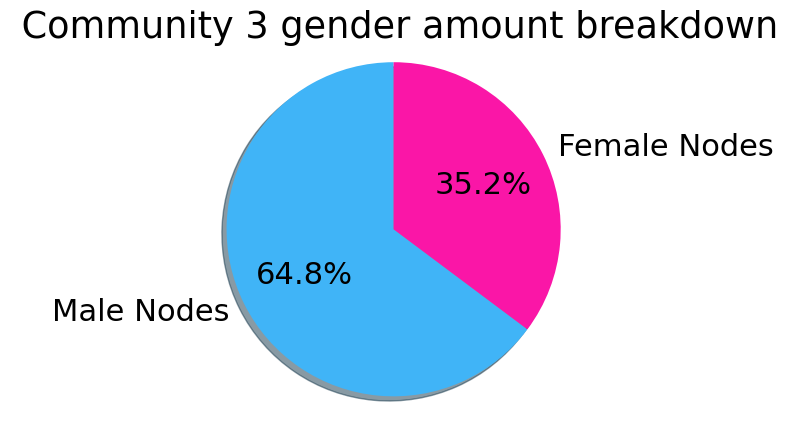

<Figure size 640x480 with 0 Axes>

In [132]:
# Pie chart for community 3, gender node amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [64.78, 35.22]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" Community 3 gender amount breakdown")
plt.show()
plt.savefig('Community_3_Gender_amount.eps', bbox_inches='tight')

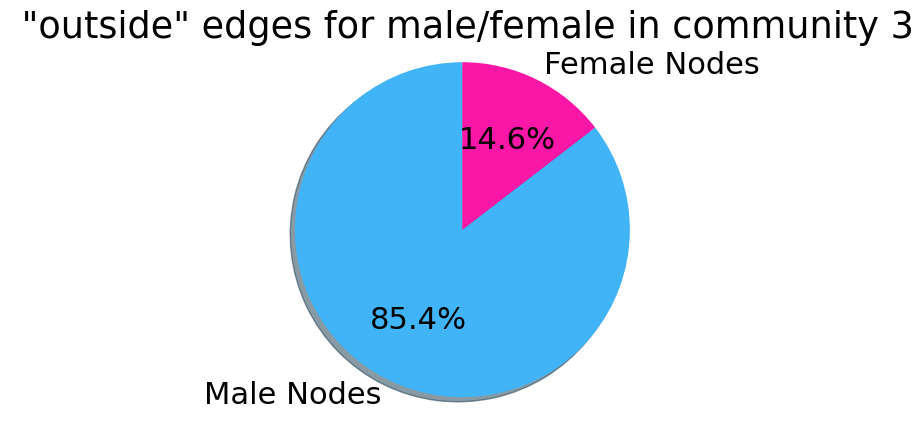

In [134]:
# Pie chart for community 3, gender link amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [85.44, 14.56]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" \"outside\" edges for male/female in community 3")
plt.show()

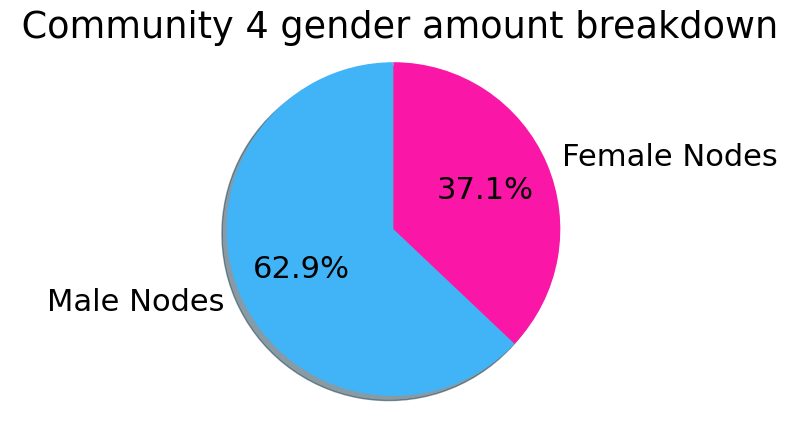

In [135]:
# Pie chart for community 4, gender node amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [64.19, 37.81]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" Community 4 gender amount breakdown")
plt.show()

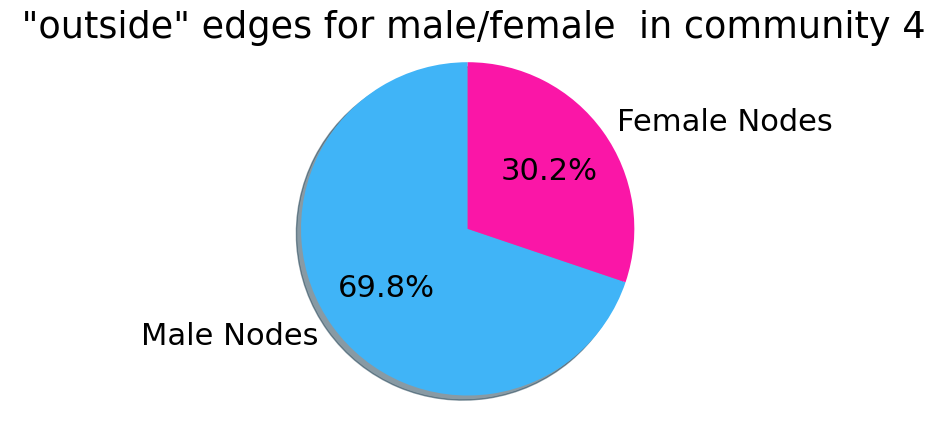

In [136]:
# Pie chart for community 4, gender link amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [69.81, 30.19]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" \"outside\" edges for male/female  in community 4")

plt.show()

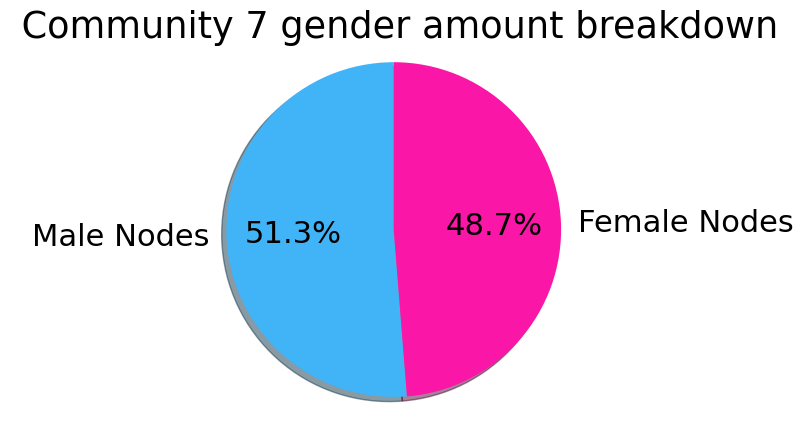

In [137]:
# Pie chart for community 7, gender node amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [51.26, 48.74]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" Community 7 gender amount breakdown")
plt.show()

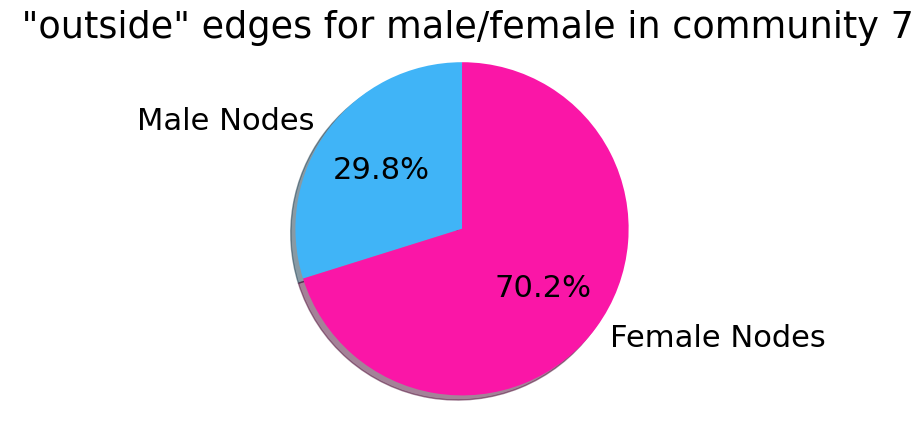

In [138]:
# Pie chart for community 7, gender link amount, hardcoded
labels = 'Male Nodes', 'Female Nodes'
sizes = [29.83, 70.17]
color= [ "#40b4f7","#fa16a7"]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, colors=color, labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')
plt.title(" \"outside\" edges for male/female in community 7")
plt.show()

# Wordclouds

In [140]:
# All characters
#t = os.listdir("drive/MyDrive/Sociale grafer/Marvel/")
t = os.listdir("completeList/")
Characters_pages = [w[0:-4] for w in t]
def group_character_with_pages(character_list,path="completeList/"):
    all_pages=[]
    for name in character_list:
        filename = path + name + ".txt"
        try:
            string = open(filename, "r", encoding="utf-8").read()
            words = string
            all_pages.append([name.replace("SEMICOLON",":"),words])
        except:
            continue
            #print(f"Error with {name}")
    return all_pages
all_pages=group_character_with_pages(Characters_pages)

In [142]:
communityTexts=[]

# Go through all top communities, find all characters in that community, append all their pages together to form 1 document
# specific to that community, so that we end up with 10 documents in total
for com in topCommunities:
    listOfCharacters=(([k for k,v in partition.items() if v == com]))
    communityTexts.append(' '.join([y for x,y in all_pages if x in listOfCharacters]))

In [143]:
block_words= [".", '[', ']', "'", ',', '{', '}',  '(' , ')' , ':', "\\'\\",'\\n','==\\n','*',"<", ">" ]
processedCommunityTexts =[]
i=0
for doc in communityTexts:
    tokens = word_tokenize(doc)
    processed= [w.lower() for w in tokens if w not in block_words ]
    processedCommunityTexts.append(' '.join(processed))
    print("community " + str(i))
    i += 1

community 0
community 1
community 2
community 3
community 4
community 5
community 6
community 7
community 8
community 9


In [ ]:
# We then use the sklearn library to create the TF-IDF vectors
vectorizer = TfidfVectorizer(stop_words='english') 
vectors = vectorizer.fit_transform(processedCommunityTexts)
feature_names = vectorizer.get_feature_names_out()

In [147]:
# We create a function that has all the logic for extracting the words and weights
# specific to one of our 10 documents. It then creates the wordcloud
def wordCloudFromdoc(doc,maxWords):
    feature_index = vectors[doc,:].nonzero()[1]
    tfidf_scores = zip(feature_index, [vectors[doc, x] for x in feature_index])
    customBlockWords={'category','gallery','thumb','characters','character','png','tv','comic','image','com','film','ref','appearance','movie','shows','jpg','br','episode'}.union(STOPWORDS)
    
    tempDict={}
    for w, s in [(feature_names[i], s) for (i, s) in tfidf_scores]:
      if w not in customBlockWords:
        tempDict[w]=s

    w = WordCloud(width=1500, height=1200, mode='RGBA', background_color='white', max_words=maxWords).fit_words(tempDict)
    plt.figure(figsize=(20,15))
    plt.imshow(w)
    plt.axis('off')

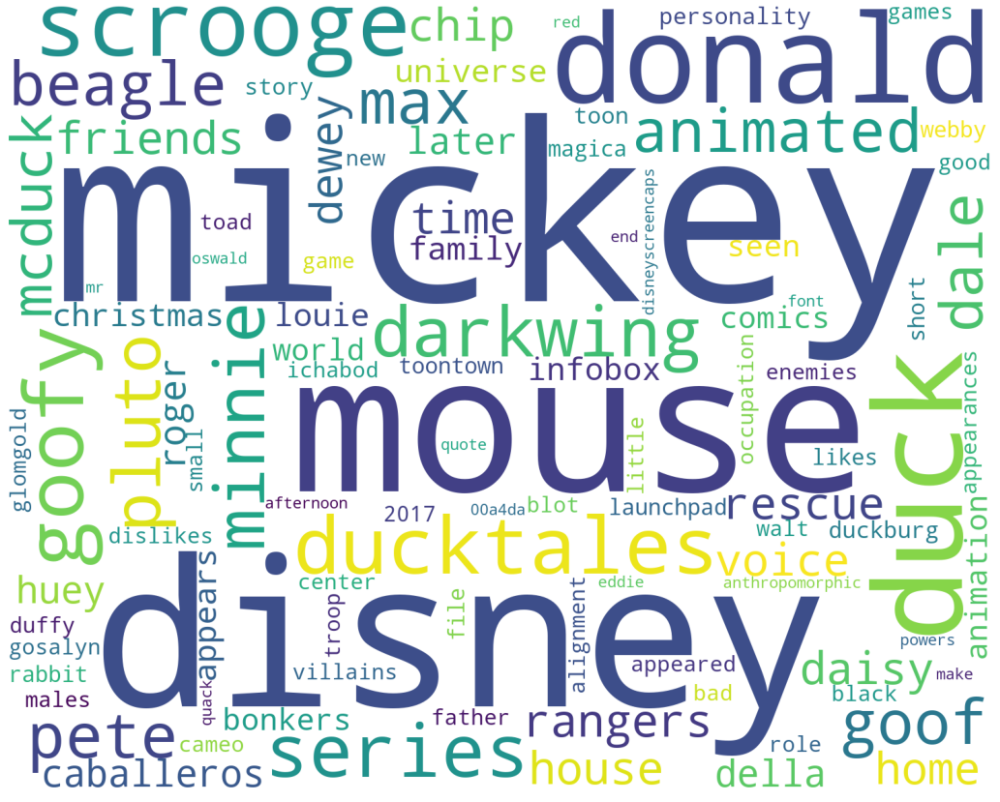

In [ ]:
wordCloudFromdoc(0,100)

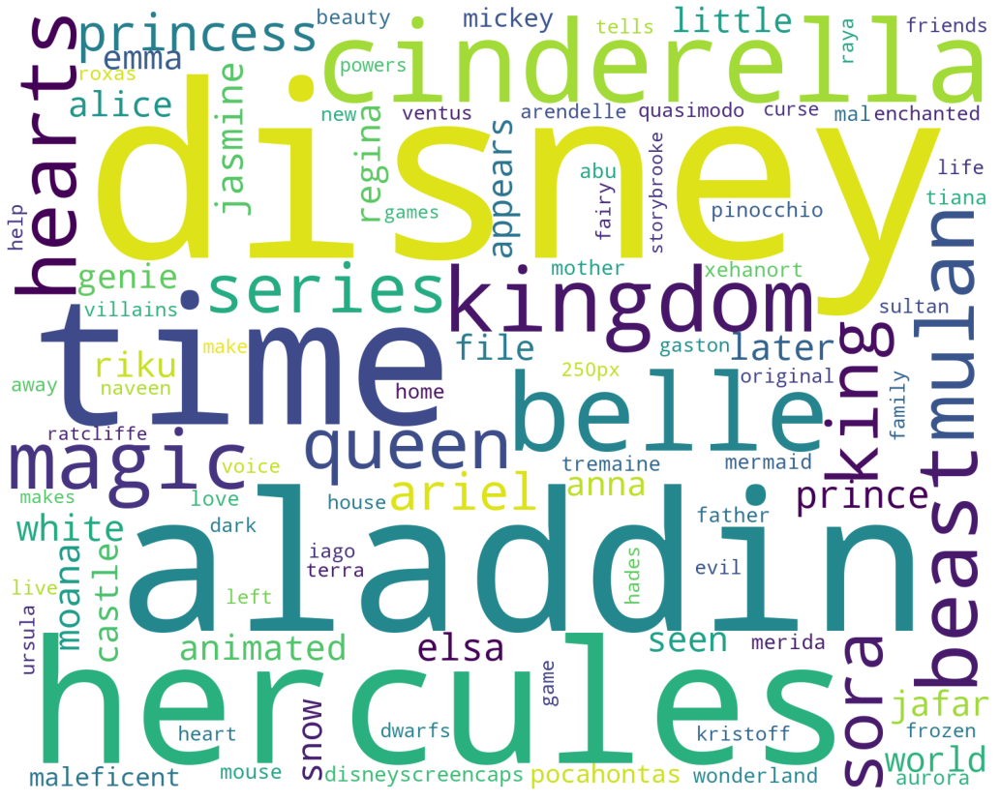

In [ ]:
wordCloudFromdoc(1,100)

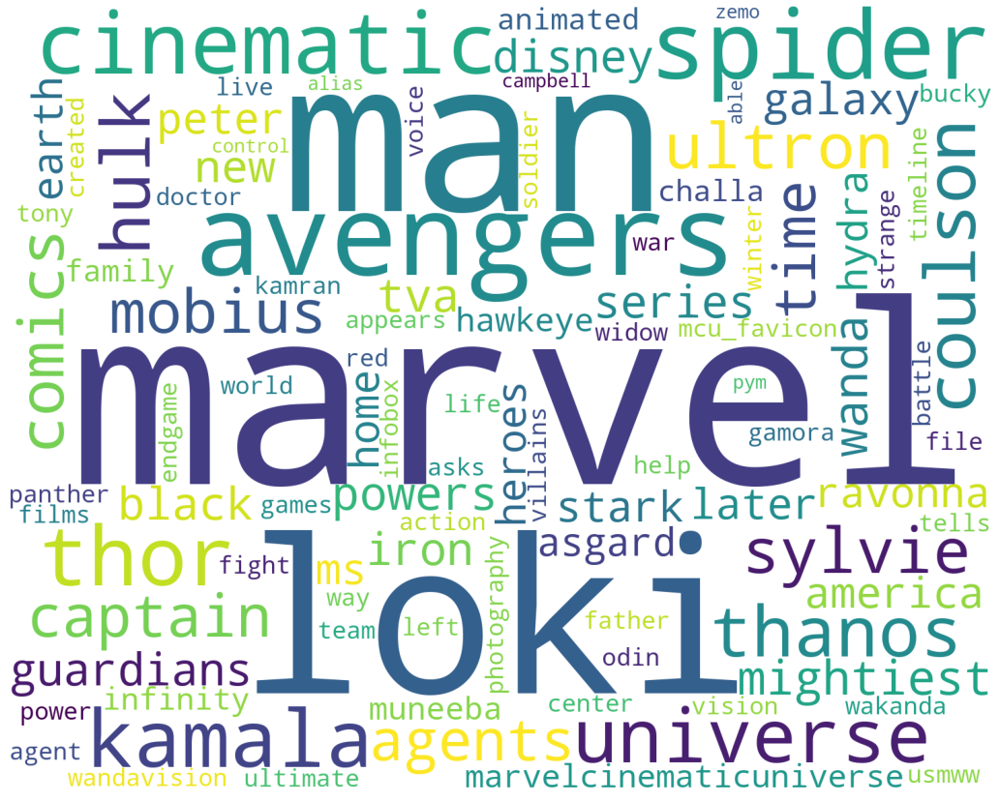

In [ ]:
wordCloudFromdoc(2,100)

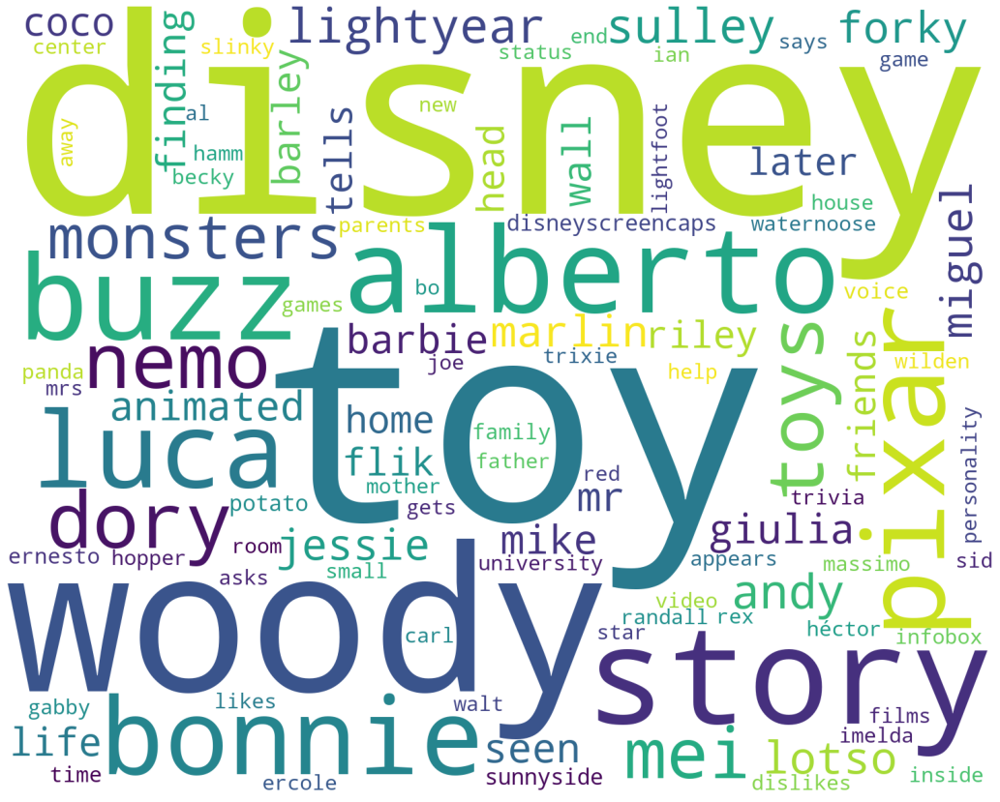

In [ ]:
wordCloudFromdoc(3,100)

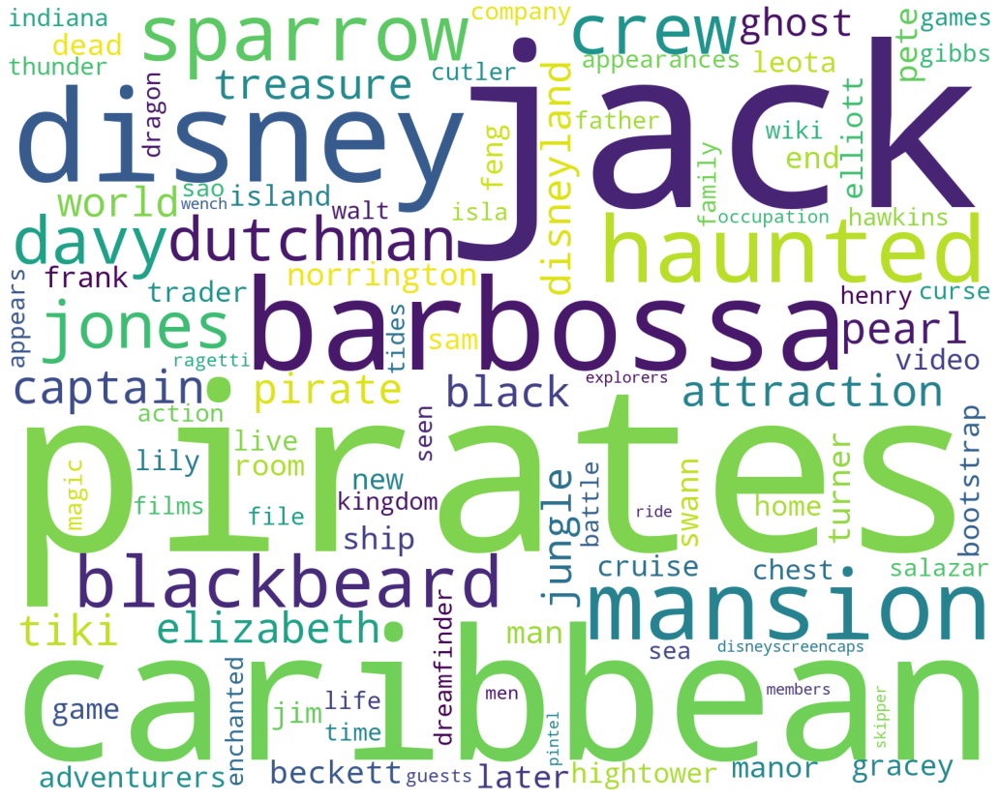

In [ ]:
wordCloudFromdoc(4,100)

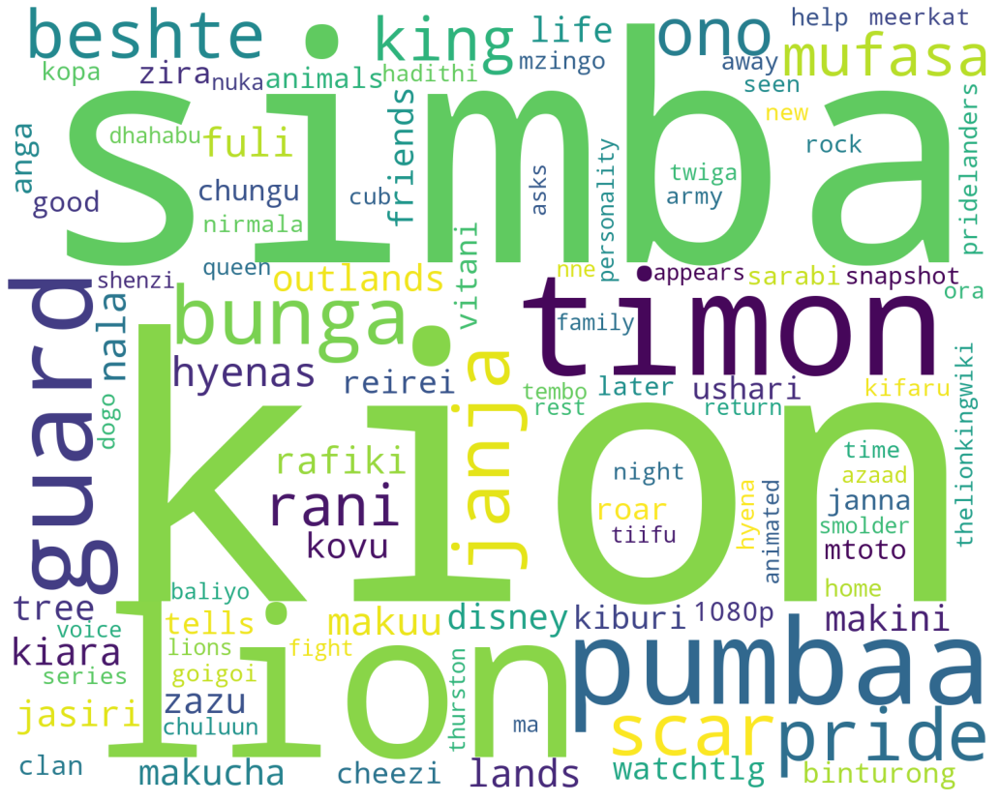

In [ ]:
wordCloudFromdoc(5,100)

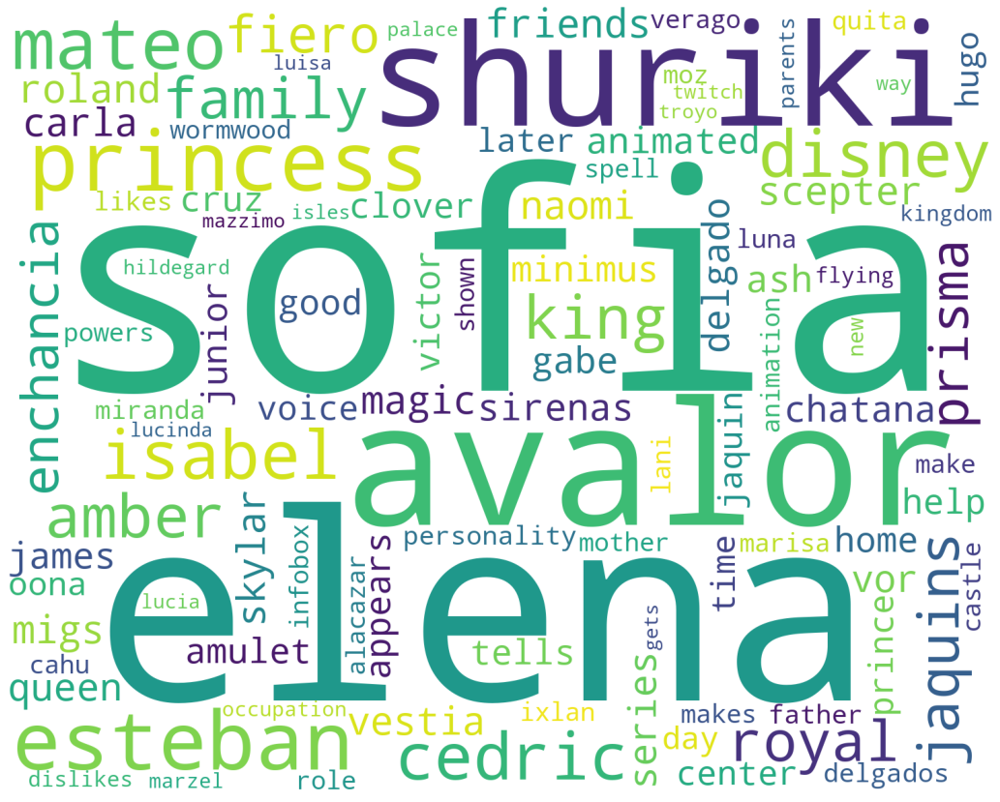

In [ ]:
wordCloudFromdoc(6,100)

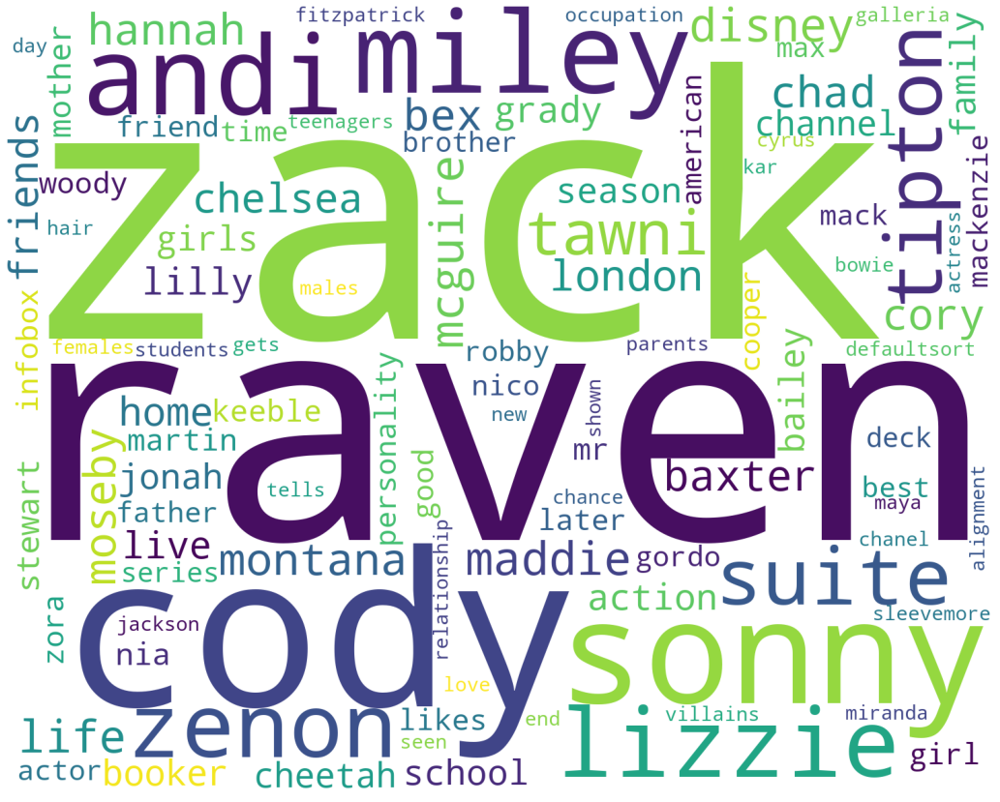

In [ ]:
wordCloudFromdoc(7,100)

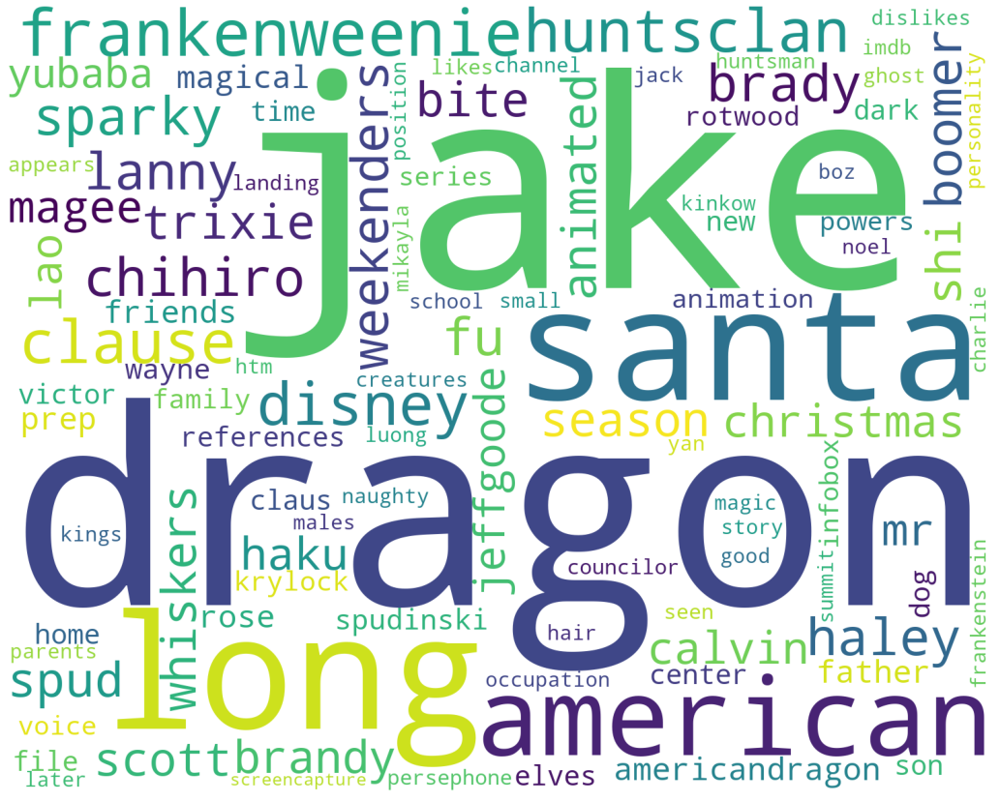

In [ ]:
wordCloudFromdoc(8,100)

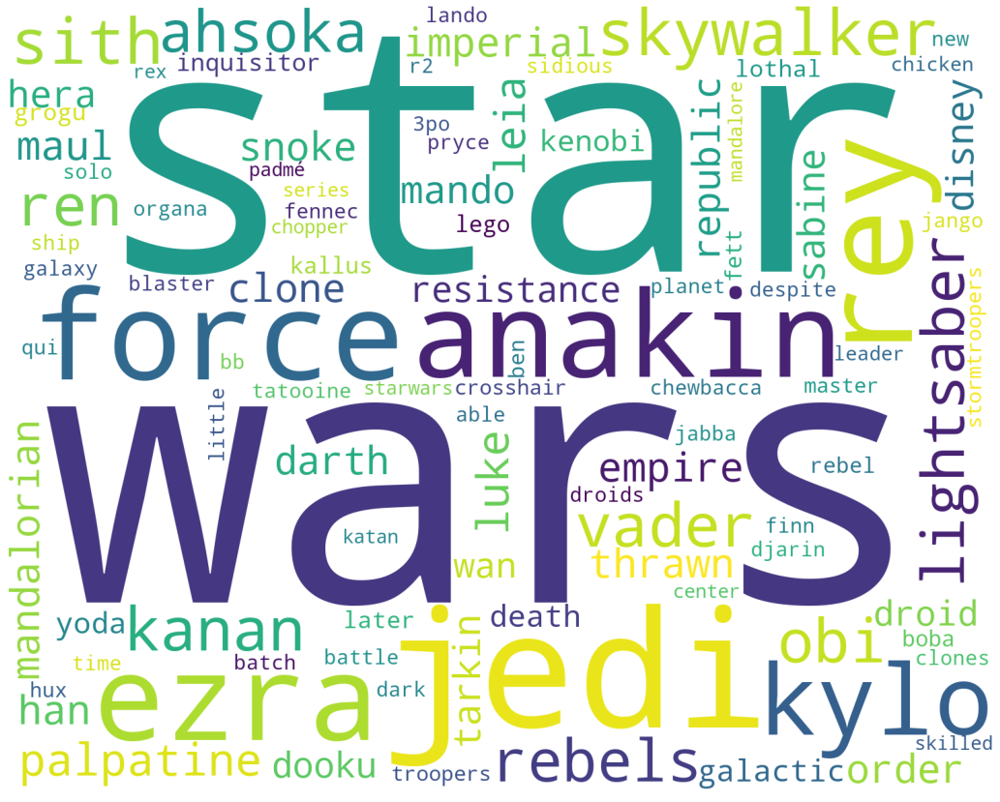

In [ ]:
wordCloudFromdoc(9,100)

# Sentiment Score

In [12]:
#Sentiment functions
#open sentiment from file
def open_sentiment_from_file(filename):
    sentiment_file=open_file(filename)
    string=sentiment_file[0]
    sentiments= string.split("|||")
    sen_from_file=[[name.split("|'|")[0],float(name.split("|'|")[1])] for name in sentiments[:-1]]
    return sen_from_file

def universes_sentiment(universes,sentiment):
    universe_sentiment_scores=[]
    for name,universe in universes:
        universe_sentiment_scores.append([name, [[name,score] for name,score in sentiment if name in universe]] )
    return universe_sentiment_scores

def open_file(filename,place=""):
    text_file = open(place+filename.replace(":","SEMICOLON")+".txt", "r", encoding= 'utf-8') # ':' can't be part of filename
    return text_file.readlines()

In [95]:
#Analysis and plotting
def group_character_with_pages(character_list,path="CharacterPages//"):
    all_pages=[]
    for name in character_list:
        filename = path + name + ".txt"
        try:
            string = open(filename, "r", encoding="utf-8").read()
            words = string
            all_pages.append([name.replace("SEMICOLON",":"),words])
        except:
            continue
            #print(f"Error with {name}")
    return all_pages

#Creating a histogram.
def make_histogram(data_in,title='Sentiment distribution of all characters'):
    # Histogram of data
    plt.hist(data_in[0],50) #plotting all heroes sentiment, in 20 buckets
    plt.title(f'{title} ({len(data_in[0])} total)')
    plt.axvline(x =data_in[1] , color = 'b', label = 'mean')
    plt.axvline(x =data_in[2] , color = 'r', label = "10'th percentile")
    plt.axvline(x =data_in[3] , color = 'g', label = "90'th percentile")
    plt.ylabel('Number of characters')
    plt.xlabel('Sentiment score')
    plt.legend()
    return plt

#calculating mean
def calculate_mean_and_quantiles(sentiment):
    total=[total for hero,total in sentiment]
    mean=np.mean(total)
    #print(f"{len(total)} heroes in total. ")
    #print(f"The mean sentiment is {mean:5.4f}.") 
    #calculate the 10th and 90th percentile
    tenth=np.quantile(total, 0.1)
    ninties=np.quantile(total, 0.9)
    #print(f"10th and 90th percentile values for the sentiment are, 10'th: {tenth:5.4f} and 90'th: {ninties:5.4f}.")
    return [total,mean,tenth,ninties]
#Calculate and prettify 
def calculate_and_plot(universe):
    data=calculate_mean_and_quantiles(universe[1])
    plot= make_histogram(data,universe[0])
    return plot

### Statistical analysis 

##Generate random set from a total set of all characters. subset is used in analysis
def randomset(totalset,subset):
    plt.rcParams.update(plt.rcParamsDefault)
    total=[value for char,value in totalset]   
    #size of dataset
    set_size=len(subset[1]) #Lenght of Female list
    #Generate a random set from our total universe
    R_list_female=[]
    for i in range(1000):
        R= ['placeholder',np.mean(np.random.choice(total,set_size,replace=False))] #random from the total characterlist, replace=false, so w
        R_list_female+=[R]
    R_data=calculate_mean_and_quantiles(R_list_female)
    fig, axs = plt.subplots(2,1, sharex=True, tight_layout=True)    
    y, binEdges = np.histogram(R_data[0], bins=50)
    bincenters = 0.5 * (binEdges[1:] + binEdges[:-1])
    axs[0].plot(bincenters, y, '-', c='black')#make_histogram(R_data_good,'randomly generated good characters')
    axs[0].axvline(x =np.mean(R_data[0]) , color = 'b', label = 'Randomly generated set mean', alpha = 0.5)
    y, binEdges = np.histogram([value for name,value in subset[1]], bins=50)
    bincenters = 0.5 * (binEdges[1:] + binEdges[:-1])
    axs[1].plot(bincenters, y, '-', c='black')#make_histogram(R_data_good,'randomly generated good characters')
    axs[1].axvline(x =np.mean([value for name,value in subset[1]]) , color = '#fa16a7', label = f'{subset[0]} mean')
    fig.legend(bbox_to_anchor = (0.5, 0.45, 0.5, 0.5), loc = 'upper left')
    plt.xlim([5.3, 5.8])
    plt.savefig('statistic.svg', format='svg', dpi=1200)
    plt.show()
    in_99_range(R_data,subset[1])
    return R_data

## analyze if the randomset is within the 99% range
def in_99_range(random,subset):
    upper_quantile99=random[1]+np.std(random[0])*3
    lower_quantile99=random[1]-np.std(random[0])*3
    female_mean=np.mean([value for name,value in subset])
    inrange= (lower_quantile99 <=female_mean  and female_mean <= upper_quantile99 )
    if inrange:
        print("The result is withing the statistical norm")
    else:
        print("With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.")
    return inrange

### Generate a list of all characters

In [17]:
Characters = list(G.nodes())

### Generate gender lists

In [18]:
Males = [name for name in Characters if nx.get_node_attributes(G, "gender")[name] == "Male"]
Females = [name for name in Characters if nx.get_node_attributes(G, "gender")[name] == "Female"]

### Generating universe lists

In [19]:
Disney_characters = [name for name in Characters if nx.get_node_attributes(G, "universe")[name] == "Disney"]
Pixar_characters = [name for name in Characters if nx.get_node_attributes(G, "universe")[name] == "Pixar"]
Marvel_Comics_characters = [name for name in Characters if nx.get_node_attributes(G, "universe")[name] == "Marvel"]
Star_Wars_characters = [name for name in Characters if nx.get_node_attributes(G, "universe")[name] == "Star Wars"]

### Generate Villians and heroes/heroines

In [65]:
Villains = [name for name in Characters if nx.get_node_attributes(G, "good_vs_bad")[name] == "Villain"]
Villains_female = [Villain for Villain in Villains if Villain in Females]
Villains_male = [Villain for Villain in Villains if Villain in Males]
Villains_undefined = [Villain for Villain in Villains if Villain not in (Villains_female+Villains_male)]

Heroes = [name for name in Characters if nx.get_node_attributes(G, "good_vs_bad")[name] == "Hero"]
Heroines = [name for name in Characters if nx.get_node_attributes(G, "good_vs_bad")[name] == "Heroine"]

In [66]:
#Gathering all list into one list for further analysis
universes = [["all characters",Characters],["Males",Males],["Females",Females],["Star wars",Star_Wars_characters],["Marvel comics",Marvel_Comics_characters],["Pixar",Pixar_characters],["Disney",Disney_characters],["Villains",Villains],["Villains, Female",Villains_female],["Villains, Male",Villains_male],["Villains, Undefined",Villains_undefined],["Heroes",Heroes],["Heroines",Heroines]]

In [67]:
#Get sentiment from a file
sentiment_from_file=open_sentiment_from_file("sentiment")

In [68]:
universe_sentiment_scores=universes_sentiment(universes,sentiment_from_file)

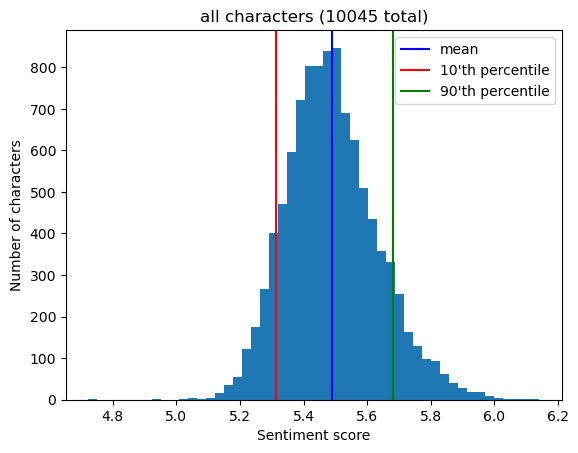

In [69]:
plot=calculate_and_plot(universe_sentiment_scores[0]) # Histogram of all characters sentiment scores. 
plot.savefig('all.svg', format='svg', dpi=1200)

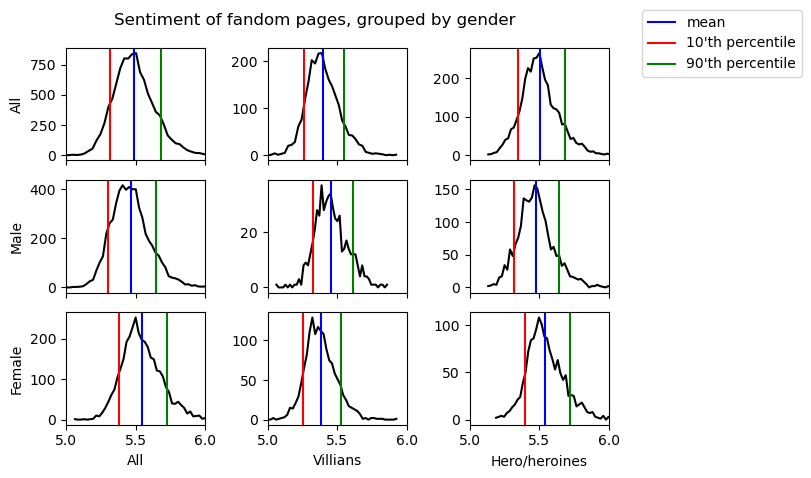

In [86]:
#Creating a histogram.
    # Histogram of data

plots=[0,1,2,7,8,9]
plotlist=[]
#adding first 
for i in plots:
    plotlist.append(universe_sentiment_scores[i])
plotlist.append(["All hero(m/f)",universe_sentiment_scores[11][1]+universe_sentiment_scores[12][1]])
plots=[11,12]
for i in plots:
    plotlist.append(universe_sentiment_scores[i])

i=0
fig, axs = plt.subplots(3,3, sharex=True, tight_layout=True)   #Create subplot
for universe in plotlist:
    if i>=9:
        break
    data_in=calculate_mean_and_quantiles(universe[1])
    #axs[i].hist(data_in[0],50) #plotting all heroes sentiment, in 20 buckets
    y, binEdges = np.histogram(data_in[0], bins=50)
    #plt.subplot(212)
    bincenters = 0.5 * (binEdges[1:] + binEdges[:-1])
    axs.flatten(order='F')[i].plot(bincenters, y, '-', c='black')
    if i>0:
        axs.flatten(order='F')[i].axvline(x =data_in[1] , color = 'b')
        axs.flatten(order='F')[i].axvline(x =data_in[2] , color = 'r')
        axs.flatten(order='F')[i].axvline(x =data_in[3] , color = 'g')
       
    else:
        axs.flatten(order='F')[i].axvline(x =data_in[1] , color = 'b', label = 'mean')
        axs.flatten(order='F')[i].axvline(x =data_in[2] , color = 'r', label = "10'th percentile")
        axs.flatten(order='F')[i].axvline(x =data_in[3] , color = 'g', label = "90'th percentile")
        
    i+=1

axs.flatten(order='F')[0].set(ylabel='All')
axs.flatten(order='F')[1].set(ylabel='Male')
axs.flatten(order='F')[2].set(ylabel='Female')
axs.flatten(order='F')[2].set(xlabel='All')
axs.flatten(order='F')[5].set(xlabel='Villians')
axs.flatten(order='F')[8].set(xlabel='Hero/heroines')

fig.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')
plt.xlim([5, 6])    
fig.suptitle("Sentiment of fandom pages, grouped by gender")
plt.show()    
#plt.rcParams.update(plt.rcParamsDefault)

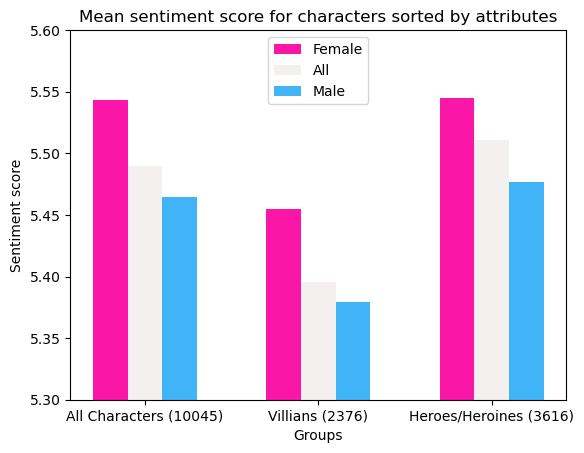

<Figure size 30000x30000 with 0 Axes>

In [106]:
#Create a chart with mean
plt.rcParams.update(plt.rcParamsDefault)
fig, axs = plt.subplots()   #Create subplot
#Group by unsorted,female,male
neutral_chart_data=[calculate_mean_and_quantiles(universe_sentiment_scores[0][1])[1],calculate_mean_and_quantiles(universe_sentiment_scores[7][1])[1],(calculate_mean_and_quantiles(universe_sentiment_scores[11][1])[1]+calculate_mean_and_quantiles(universe_sentiment_scores[12][1])[1])/2] 
female_chart_data=[calculate_mean_and_quantiles(universe_sentiment_scores[2][1])[1],calculate_mean_and_quantiles(universe_sentiment_scores[8][1])[1],calculate_mean_and_quantiles(universe_sentiment_scores[12][1])[1]] 
male_chart_data=[calculate_mean_and_quantiles(universe_sentiment_scores[1][1])[1],calculate_mean_and_quantiles(universe_sentiment_scores[9][1])[1],calculate_mean_and_quantiles(universe_sentiment_scores[11][1])[1]] 
result=[]
for universe in universe_sentiment_scores:
    result+=calculate_mean_and_quantiles(universe[1])
#Groups
X=[f'All Characters ({len(universe_sentiment_scores[0][1])})',f'Villians ({len(universe_sentiment_scores[7][1])})',f'Heroes/Heroines ({len(universe_sentiment_scores[12][1])+len(universe_sentiment_scores[11][1])})']
#setup chart
X_axis=np.arange(len(X))
plt.bar(X_axis - 0.2, female_chart_data, 0.2, label = 'Female',color='#fa16a7')
plt.bar(X_axis - 0.0, neutral_chart_data, 0.2, label = 'All',color='#f5f0f0')
plt.bar(X_axis + 0.2, male_chart_data, 0.2, label = 'Male', color='#40b4f7')
plt.xticks(X_axis,X)
plt.xlabel("Groups")
plt.ylabel("Sentiment score")
plt.title("Mean sentiment score for characters sorted by attributes")
#Limit y axis to make chart more readable
plt.ylim([5.3, 5.6])
plt.legend()
plt.figure(figsize=(300, 300))
plt.rcParams.update({'font.size': 22})
plt.savefig('gender.eps', bbox_inches='tight')
fig.savefig('gender.svg', format='svg', dpi=1200)

## Statistical analysis

We want to prove that the males and females are statistically different from a randomly generated collection of characters. 
This is done by creating 1000 means from randomly picked collections of characters, where the collection share the size with the collection we are analyzing.

We use the following formula 
\begin{aligned}Pr(\mu -3\sigma \leq X\leq \mu +3\sigma )&\approx 99.73\%\end{aligned}
If our subgroup of characters lies outside this interval, the hypothesis holds.

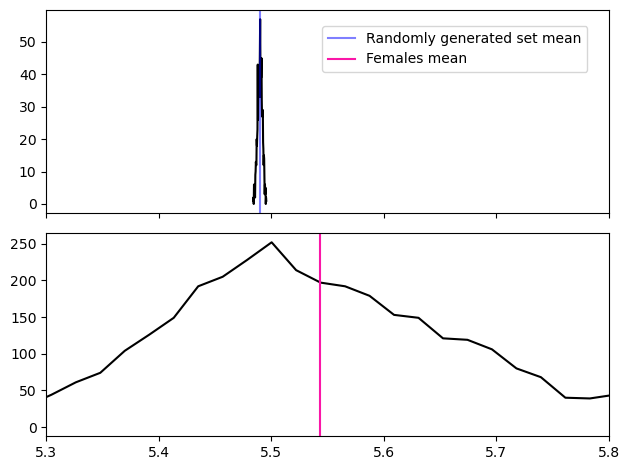

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [102]:
#Female comparison
r_female=randomset(universe_sentiment_scores[0][1],universe_sentiment_scores[2])


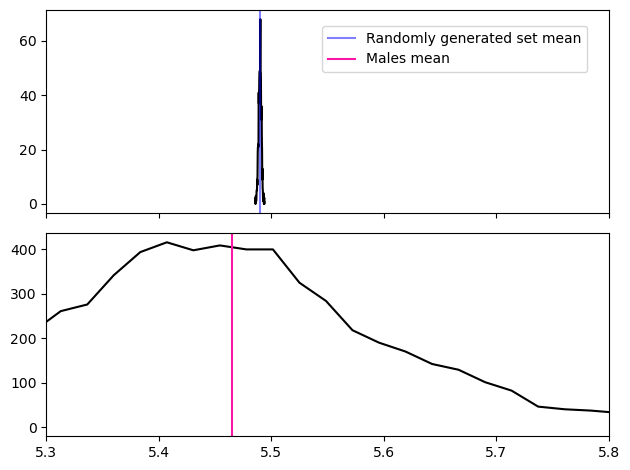

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [97]:
#Male comparison
r_male=randomset(universe_sentiment_scores[0][1],universe_sentiment_scores[1])

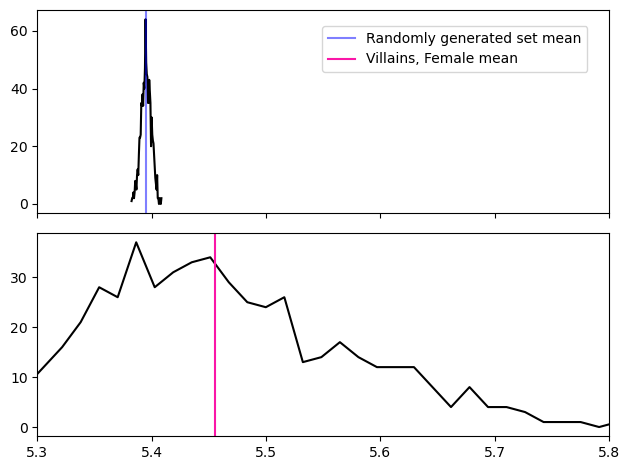

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [103]:
#Female Villain comparison
r_villain_female=randomset(universe_sentiment_scores[7][1],universe_sentiment_scores[8])

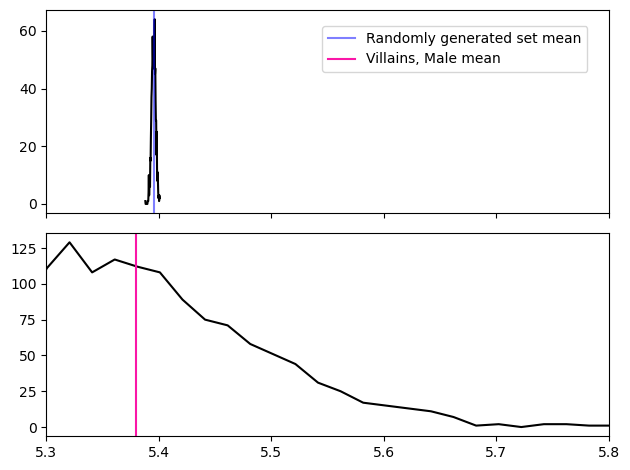

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [99]:
#Male Villain comparison
r_villain_male=randomset(universe_sentiment_scores[7][1],universe_sentiment_scores[9])

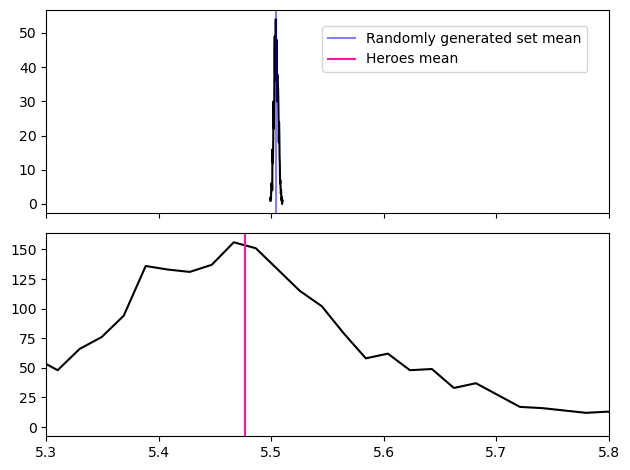

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [100]:
#Male hero comparison
r_hero_male=randomset(universe_sentiment_scores[11][1]+universe_sentiment_scores[12][1],universe_sentiment_scores[11])

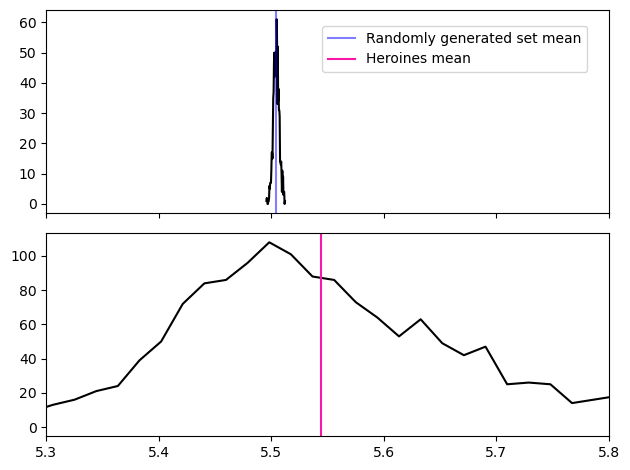

With 99% certaincy, there is a statistical difference of the subset of characters from a randomly generated sample of characters.


In [101]:
#Female hero comparison
r_hero_female=randomset(universe_sentiment_scores[11][1]+universe_sentiment_scores[12][1],universe_sentiment_scores[12])